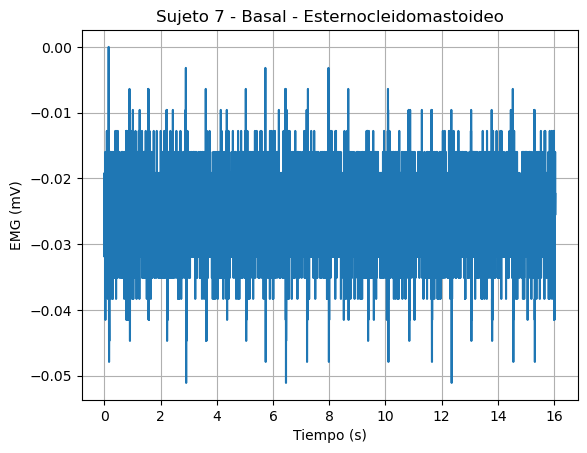

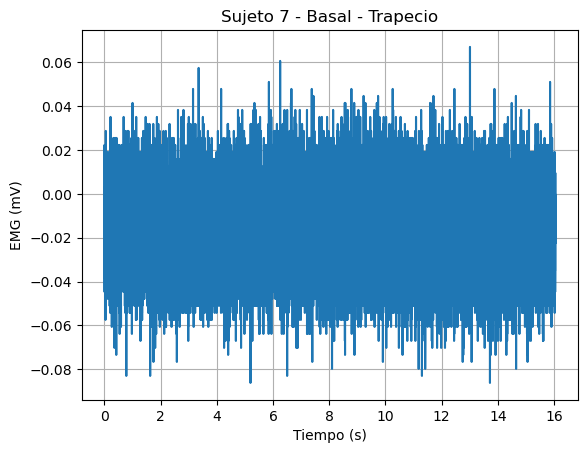

In [2]:
# Importar librerías
import numpy as np
import matplotlib.pyplot as plt

# Definir constantes
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_basal.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
conversion_factor = 3.3 / (1024 * 1009)
skip_lines = 7

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para graficar la señal
def graficar_senal(senalmV, titulo):
    num_muestra = np.arange(len(senalmV))
    t = num_muestra / fs
    plt.plot(t, senalmV)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('EMG (mV)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
graficar_senal(senalmV_esternocleidomastoideo, 'Sujeto 7 - Basal - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
graficar_senal(senalmV_trapecio, 'Sujeto 7 - Basal - Trapecio')



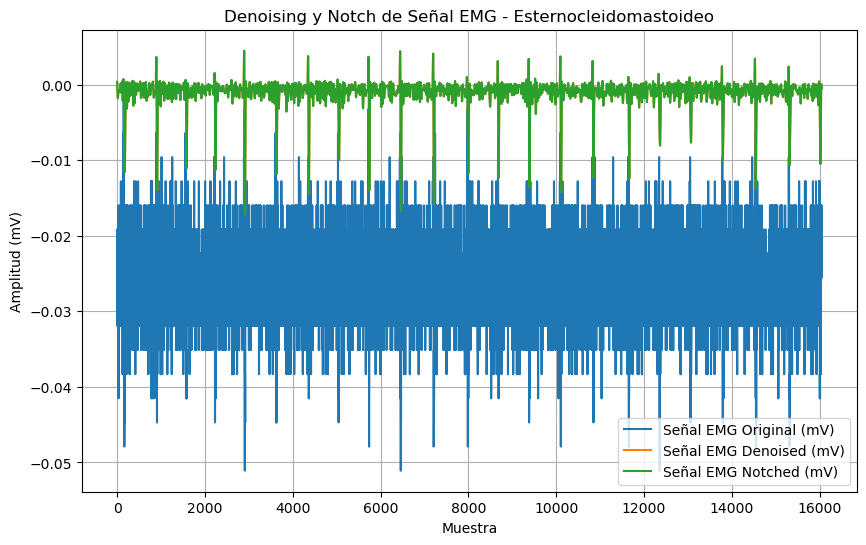

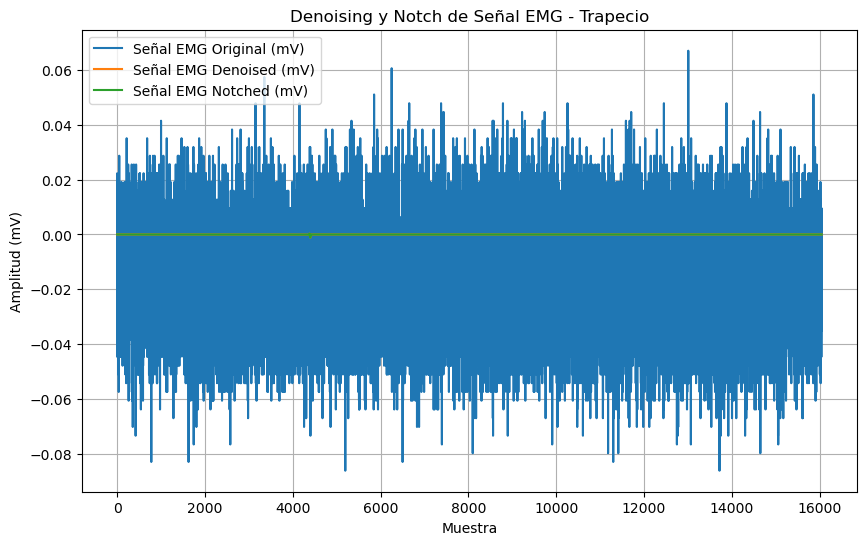

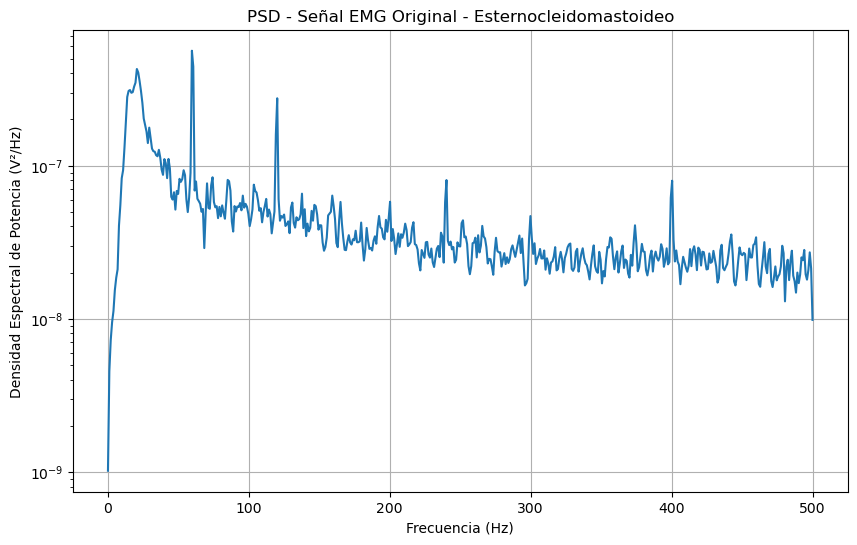

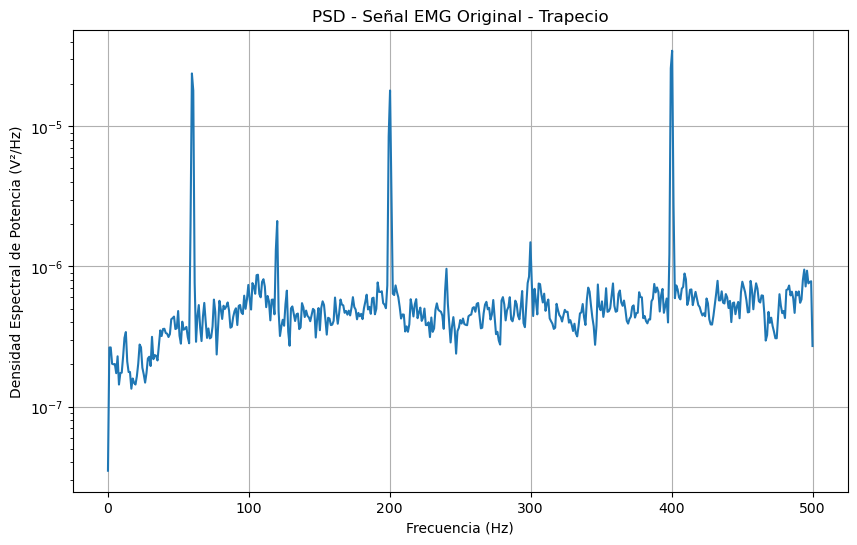

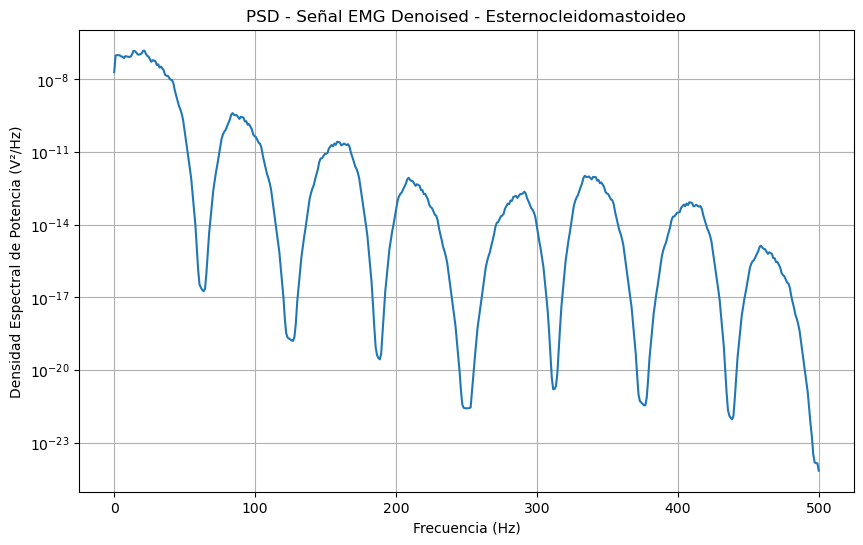

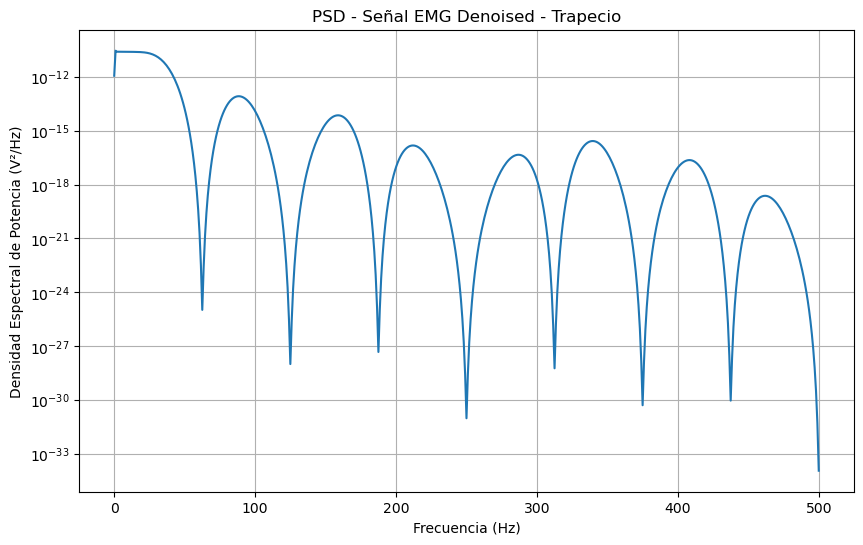

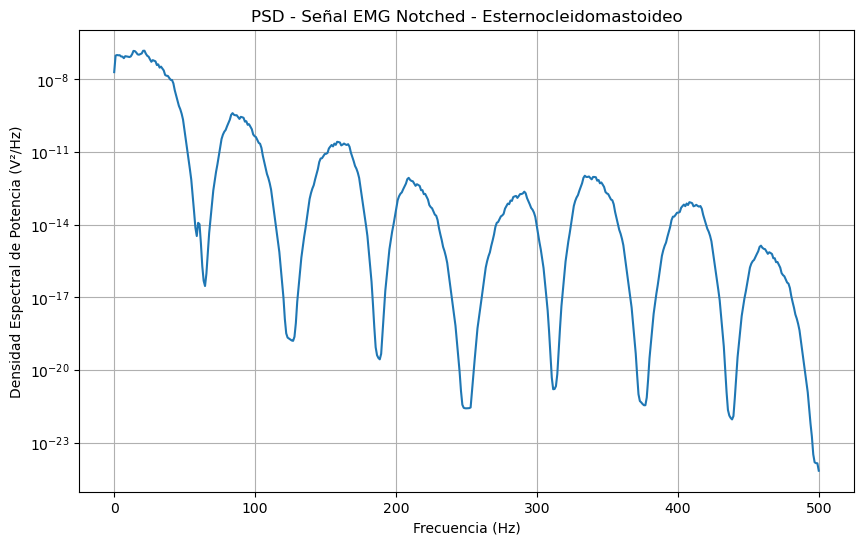

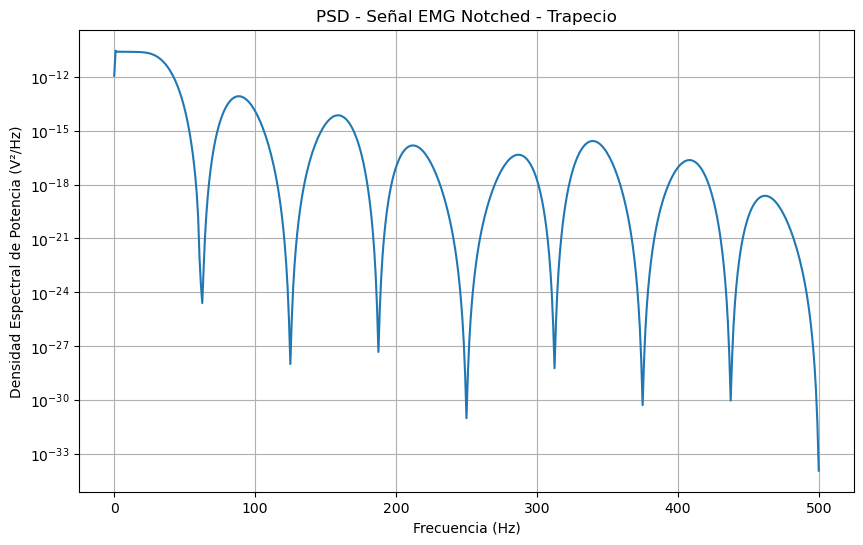

Se necesitaba filtro notch para esternocleidomastoideo: True
Se necesitaba filtro notch para trapecio: True


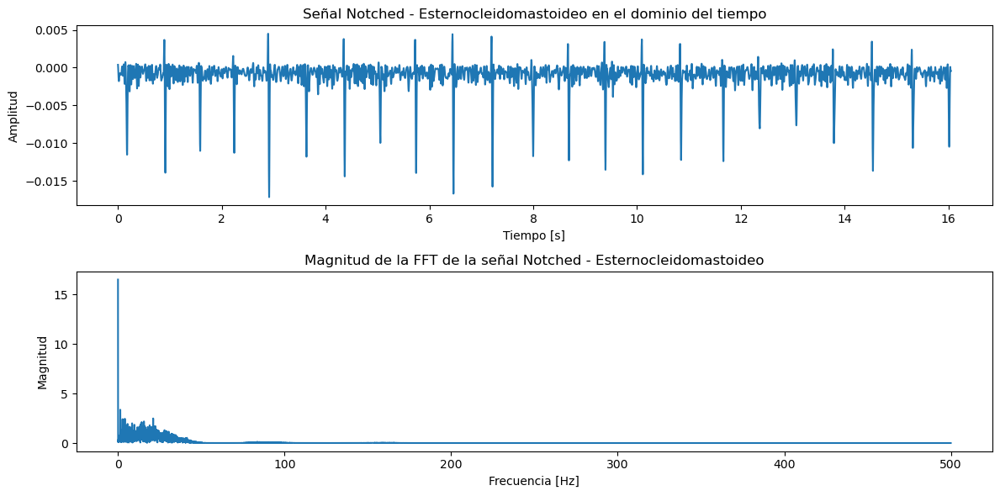

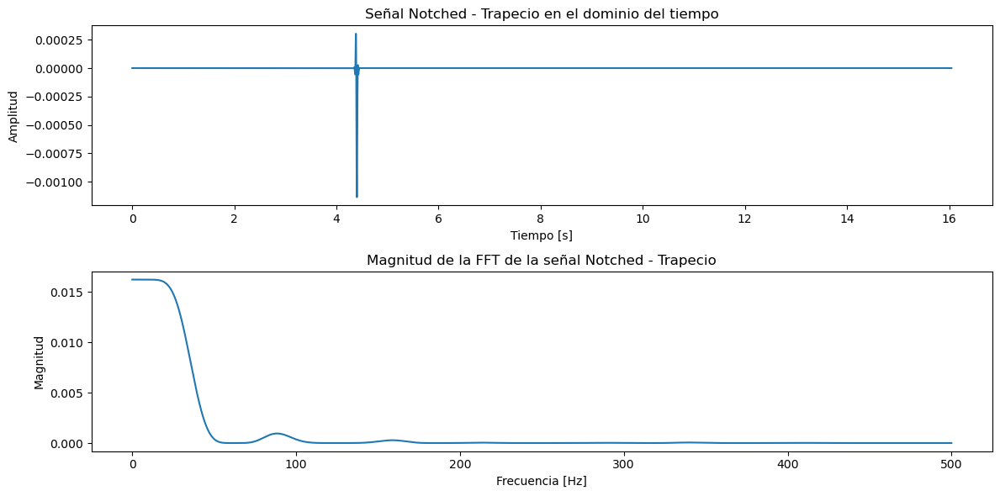

Maximum EMG - Esternocleidomastoideo: 0.004502213515246573
Minimum EMG - Esternocleidomastoideo: -0.017161628395218943
Average EMG - Esternocleidomastoideo: -0.0010286526369288423
Standard Deviation EMG - Esternocleidomastoideo: 0.0017757825002822328


Burst End Times - Esternocleidomastoideo: [ 0.63803976  1.30508133  1.90111848  2.5561593   3.24320212  5.38633568
  6.81042443  7.55547086  8.3215186   9.01856204  9.80361097 10.43665042
 11.18369698 12.01374871 13.38283403 14.11387959 14.88992795 15.62297364
 15.82598629]
Maximum time - Esternocleidomastoideo: 1.9541217824867556
Minimum time - Esternocleidomastoideo: 0.0030001869741358433
Average time - Esternocleidomastoideo: 0.6649361762149217
Standard Deviation time - Esternocleidomastoideo: 0.4060190672979971


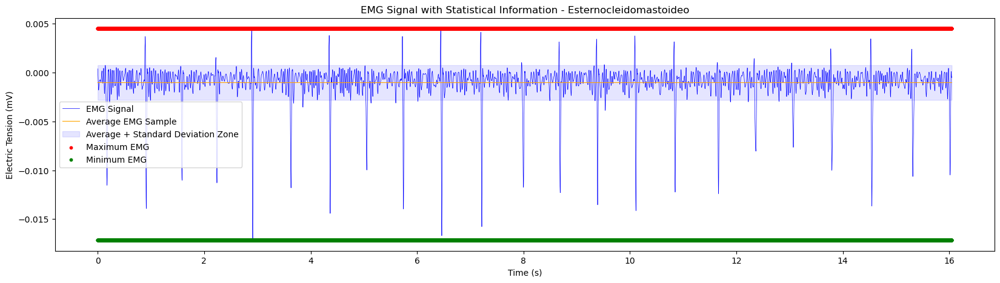

Características de la señal EMG:
  RMS: 0.002050447246942371
  Min: -0.06125600728246088
  Max: 0.0014844168693443848
  Median: -1.8284383635115567e-10
  MAV: 0.0002578287029919583
  Std Dev: 0.0020342803350426254
El valor RMS de la señal EMG - Esternocleidomastoideo es: 0.0020522011928096324


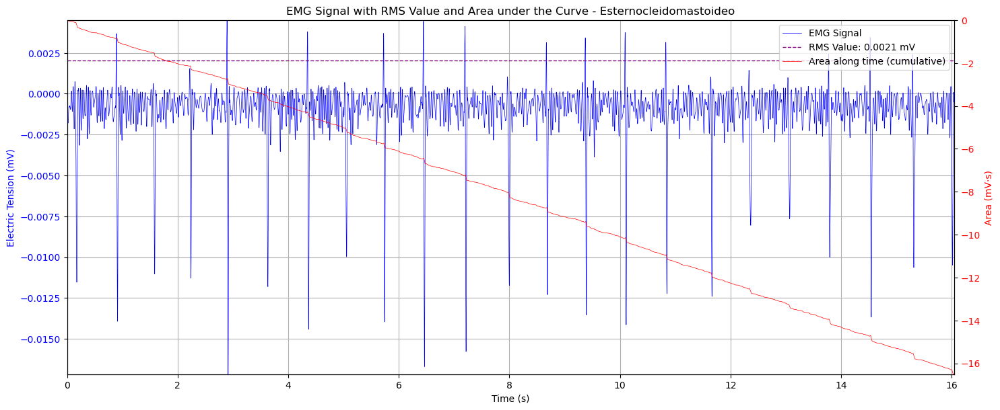

Frecuencia mediana (MDF) - Esternocleidomastoideo: 5.733516141094354 Hz
Frecuencia media (MNF) - Esternocleidomastoideo: 9.957641929309816 Hz
Maximum EMG - Trapecio: 0.0003033924834067516
Minimum EMG - Trapecio: -0.0011370367502158728
Average EMG - Trapecio: -1.0114758610768932e-06
Standard Deviation EMG - Trapecio: 3.2009284507068035e-05


Burst End Times - Trapecio: [4.72329436]
Maximum time - Trapecio: 0.5270328451230908
Minimum time - Trapecio: 0.5270328451230908
Average time - Trapecio: 0.5270328451230908
Standard Deviation time - Trapecio: 0.0


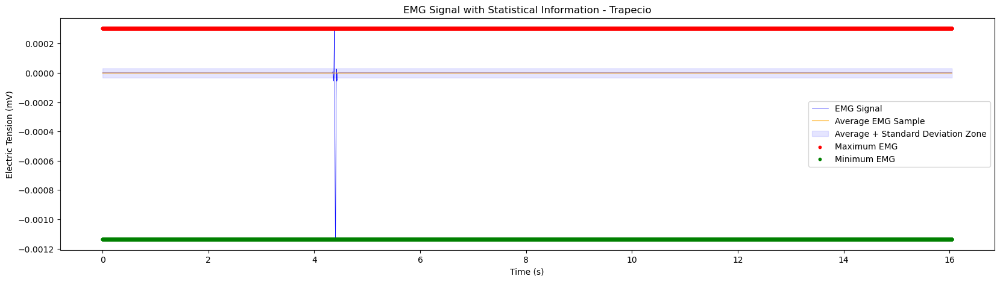

Características de la señal EMG:
  RMS: 3.199138609240265e-05
  Min: -0.004056729565251437
  Max: 5.975385392691287e-07
  Median: 2.0573371172230608e-44
  MAV: 2.525521014184013e-07
  Std Dev: 3.1990390924748204e-05
El valor RMS de la señal EMG - Trapecio es: 3.2025261561335713e-05


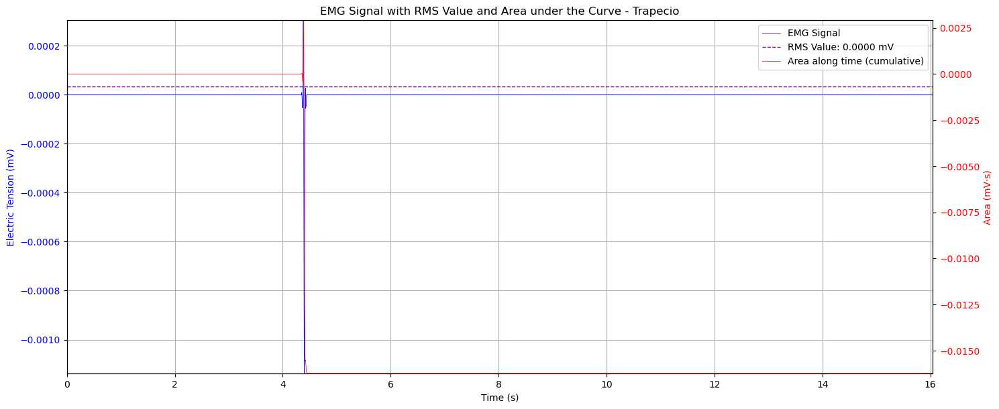

Frecuencia mediana (MDF) - Trapecio: 15.642527732768292 Hz
Frecuencia media (MNF) - Trapecio: 16.335946076569325 Hz


In [13]:

# Importar librerías
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt

# Definir constantes y parámetros
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_basal.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para descomponer y denoising la señal usando transformada wavelet
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Función para aplicar filtro notch
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Función para graficar la señal EMG original y denoised
def graficar_senal(senalmV, emg_denoised, emg_notched, titulo):
    plt.figure(figsize=(10, 6))
    plt.plot(senalmV, label='Señal EMG Original (mV)')
    plt.plot(emg_denoised, label='Señal EMG Denoised (mV)')
    plt.plot(emg_notched, label='Señal EMG Notched (mV)')
    plt.xlabel('Muestra')
    plt.ylabel('Amplitud (mV)')
    plt.title(titulo)
    plt.legend()
    plt.grid(True)
    plt.show()

# Función para calcular y graficar la densidad espectral de potencia
def graficar_psd(senalmV, fs, titulo):
    f, Pxx = welch(senalmV, fs, nperseg=1024)
    plt.figure(figsize=(10, 6))
    plt.semilogy(f, Pxx)
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Densidad Espectral de Potencia (V²/Hz)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()
    return f, Pxx

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar, denoising y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
emg_denoised_esternocleidomastoideo = denoise_signal(senalmV_esternocleidomastoideo, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_esternocleidomastoideo = apply_notch_filter(emg_denoised_esternocleidomastoideo, f0, Q, fs)
graficar_senal(senalmV_esternocleidomastoideo, emg_denoised_esternocleidomastoideo, emg_notched_esternocleidomastoideo, 'Denoising y Notch de Señal EMG - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
emg_denoised_trapecio = denoise_signal(senalmV_trapecio, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_trapecio = apply_notch_filter(emg_denoised_trapecio, f0, Q, fs)
graficar_senal(senalmV_trapecio, emg_denoised_trapecio, emg_notched_trapecio, 'Denoising y Notch de Señal EMG - Trapecio')

# Graficar la densidad espectral de potencia de las señales originales
f_esternocleidomastoideo, Pxx_esternocleidomastoideo = graficar_psd(senalmV_esternocleidomastoideo, fs, 'PSD - Señal EMG Original - Esternocleidomastoideo')
f_trapecio, Pxx_trapecio = graficar_psd(senalmV_trapecio, fs, 'PSD - Señal EMG Original - Trapecio')

# Graficar la densidad espectral de potencia de las señales denoised
f_denoised_esternocleidomastoideo, Pxx_denoised_esternocleidomastoideo = graficar_psd(emg_denoised_esternocleidomastoideo, fs, 'PSD - Señal EMG Denoised - Esternocleidomastoideo')
f_denoised_trapecio, Pxx_denoised_trapecio = graficar_psd(emg_denoised_trapecio, fs, 'PSD - Señal EMG Denoised - Trapecio')

# Graficar la densidad espectral de potencia de las señales notched
f_notched_esternocleidomastoideo, Pxx_notched_esternocleidomastoideo = graficar_psd(emg_notched_esternocleidomastoideo, fs, 'PSD - Señal EMG Notched - Esternocleidomastoideo')
f_notched_trapecio, Pxx_notched_trapecio = graficar_psd(emg_notched_trapecio, fs, 'PSD - Señal EMG Notched - Trapecio')

# Determinar si se necesitaba el filtro notch
def check_notch_necessity(f, Pxx, f0):
    idx = np.where((f >= f0 - 1) & (f <= f0 + 1))[0]
    if np.any(Pxx[idx] > np.median(Pxx) * 10):  # Umbral arbitrario, ajustar según sea necesario
        return True
    return False

needed_notch_esternocleidomastoideo = check_notch_necessity(f_esternocleidomastoideo, Pxx_esternocleidomastoideo, f0)
needed_notch_trapecio = check_notch_necessity(f_trapecio, Pxx_trapecio, f0)

print(f"Se necesitaba filtro notch para esternocleidomastoideo: {needed_notch_esternocleidomastoideo}")
print(f"Se necesitaba filtro notch para trapecio: {needed_notch_trapecio}")

# Función para calcular y graficar la FFT de la señal
def graficar_fft(senal, fs, titulo):
    fft_result = np.fft.fft(senal)
    fft_freq = np.fft.fftfreq(len(senal), d=1/fs)
    
    # Solo mantener la mitad positiva del espectro
    positive_freq_idx = np.where(fft_freq >= 0)
    fft_freq = fft_freq[positive_freq_idx]
    fft_result = fft_result[positive_freq_idx]
    
    # Calcular la magnitud de la FFT
    fft_magnitude = np.abs(fft_result)
    
    # Graficar la señal y su FFT
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(np.arange(len(senal)) / fs, senal)
    plt.title(f'Señal {titulo} en el dominio del tiempo')
    plt.xlabel('Tiempo [s]')
    plt.ylabel('Amplitud')
    
    plt.subplot(2, 1, 2)
    plt.plot(fft_freq, fft_magnitude)
    plt.title(f'Magnitud de la FFT de la señal {titulo}')
    plt.xlabel('Frecuencia [Hz]')
    plt.ylabel('Magnitud')
    
    plt.tight_layout()
    plt.show()

# Calcular y graficar la FFT de las señales notched
graficar_fft(emg_notched_esternocleidomastoideo, fs, 'Notched - Esternocleidomastoideo')
graficar_fft(emg_notched_trapecio, fs, 'Notched - Trapecio')

# Existing imports and previous function definitions...
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt
import biosignalsnotebooks as bsnb
from scipy.integrate import cumtrapz

# Function to process, denoise, notch, and calculate statistics
def process_and_analyze_emg(signal, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, title):
    # Denoise the signal
    emg_denoised = denoise_signal(signal, wavelet, level, mode, threshold_method, threshold_value)
    # Apply notch filter
    emg_notched = apply_notch_filter(emg_denoised, f0, Q, fs)
    # Calculate EMG statistics
    max_sample_value, min_sample_value, avg_sample_value, std_sample_value = calculate_emg_statistics(emg_notched, title)
    # Detect muscle activations
    burst_begin, burst_end = detect_muscle_activations(emg_notched, fs)
    calculate_burst_statistics(burst_begin, burst_end, title)
    # Plot graphical and statistical information
    t = np.arange(len(emg_notched)) / fs
    bsnb.plot_emg_graphical_statistical(t, emg_notched, max_sample_value, min_sample_value, avg_sample_value, std_sample_value)
    # Plot the EMG signal with statistical information
    plot_emg_with_statistics(t, emg_notched, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title)
    # Perform wavelet decomposition and statistics
    wavelet_analysis(emg_notched, wavelet, level, title)
    # Plot RMS and area under the curve
    plot_rms_and_area(t, emg_notched, title)
    # Perform frequency analysis
    frequency_analysis(emg_notched, fs, title)

# Function to plot the EMG signal with statistical information
def plot_emg_with_statistics(time, smooth_signal, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title):
    # Ensure all statistical arrays match the length of the time array
    avg_sample_array = np.full_like(time, avg_sample_value)
    std_sample_array = np.full_like(time, std_sample_value)
    max_sample_array = np.full_like(time, max_sample_value)
    min_sample_array = np.full_like(time, min_sample_value)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(20, 5))

    # Plot the EMG signal
    ax.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)

    # Plot the average EMG signal
    ax.plot(time, avg_sample_array, label='Average EMG Sample', color='orange', linewidth=0.8)

    # Plot the standard deviation zone
    ax.fill_between(time, avg_sample_array - std_sample_array, avg_sample_array + std_sample_array, color='blue', alpha=0.1, label='Average + Standard Deviation Zone')

    # Plot maximum and minimum EMG values with smaller markers
    ax.scatter(time, max_sample_array, label='Maximum EMG', color='red', s=10, zorder=3)  # Marker size set to 10
    ax.scatter(time, min_sample_array, label='Minimum EMG', color='green', s=10, zorder=3)  # Marker size set to 10

    # Set labels and title
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Electric Tension (mV)')
    ax.set_title(f'EMG Signal with Statistical Information - {title}')

    # Add legend
    ax.legend()

    # Display the plot
    plt.show()

# Function to perform wavelet decomposition and calculate statistics
def wavelet_analysis(signal, wavelet, level, title):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    all_coeffs = np.concatenate(coeffs)
    rms_total = np.sqrt(np.mean(np.square(all_coeffs)))
    min_total = np.min(all_coeffs)
    max_total = np.max(all_coeffs)
    median_total = np.median(all_coeffs)
    std_dev_total = np.std(all_coeffs)
    mav_total = np.mean(np.abs(all_coeffs))
    print("Características de la señal EMG:")
    print(f"  RMS: {rms_total}")
    print(f"  Min: {min_total}")
    print(f"  Max: {max_total}")
    print(f"  Median: {median_total}")
    print(f"  MAV: {mav_total}")
    print(f"  Std Dev: {std_dev_total}")
    

# Function to calculate RMS and plot the area under the curve
def plot_rms_and_area(time, smooth_signal, title):
    rms_value = np.sqrt(np.mean(np.square(smooth_signal)))
    print(f"El valor RMS de la señal EMG - {title} es: {rms_value}")
    area = cumtrapz(smooth_signal, initial=0)

    fig, ax1 = plt.subplots(figsize=(15, 6))
    ax1.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Electric Tension (mV)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')

    ax2 = ax1.twinx()
    ax2.plot(time, area, label='Area along time (cumulative)', color='red', linewidth=0.5)
    ax2.set_ylabel('Area (mV·s)', color='red')
    ax2.tick_params(axis='y', labelcolor='red')

    ax1.axhline(y=rms_value, color='purple', linestyle='--', linewidth=1, label=f'RMS Value: {rms_value:.4f} mV')

    fig.tight_layout()
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')

    ax1.grid(True)
    ax1.set_xlim([0, max(time)])
    ax1.set_ylim([min(smooth_signal), max(smooth_signal)])
    ax2.set_ylim([min(area), max(area)])
    plt.title(f'EMG Signal with RMS Value and Area under the Curve - {title}')
    plt.show()

# Function to perform frequency analysis
def frequency_analysis(signal, fs, title):
    N = len(signal)
    freqs = np.fft.rfftfreq(N, 1/fs)
    fft_magnitude = np.abs(np.fft.rfft(signal))

    power_spectrum = fft_magnitude**2
    cumulative_power = np.cumsum(power_spectrum)
    total_power = cumulative_power[-1]
    median_freq_index = np.where(cumulative_power >= total_power / 2)[0][0]
    MDF = freqs[median_freq_index]
    print(f"Frecuencia mediana (MDF) - {title}: {MDF} Hz")

    MNF = np.sum(freqs * power_spectrum) / np.sum(power_spectrum)
    print(f"Frecuencia media (MNF) - {title}: {MNF} Hz")

# Function to detect muscle activations
def detect_muscle_activations(signal, fs, smooth_level=22, threshold_level=10):
    burst_begin, burst_end = bsnb.detect_emg_activations(signal, fs, smooth_level=smooth_level, threshold_level=threshold_level, time_units=True, plot_result=True)[:2]
    return burst_begin, burst_end

# Function to calculate and print burst durations and statistics
def calculate_burst_statistics(burst_begin, burst_end, title):
    bursts_time = burst_end - burst_begin
    print(f"Burst End Times - {title}: {burst_end}")
    
    max_time = np.max(bursts_time)
    min_time = np.min(bursts_time)
    avg_time = np.average(bursts_time)
    std_time = np.std(bursts_time)
    
    print(f"Maximum time - {title}: {max_time}")
    print(f"Minimum time - {title}: {min_time}")
    print(f"Average time - {title}: {avg_time}")
    print(f"Standard Deviation time - {title}: {std_time}")

# Function to calculate and return EMG signal statistics
def calculate_emg_statistics(signal, title):
    max_sample_value = np.max(signal)
    min_sample_value = np.min(signal)
    avg_sample_value = np.average(signal)
    std_sample_value = np.std(signal)
    
    print(f"Maximum EMG - {title}: {max_sample_value}")
    print(f"Minimum EMG - {title}: {min_sample_value}")
    print(f"Average EMG - {title}: {avg_sample_value}")
    print(f"Standard Deviation EMG - {title}: {std_sample_value}")
    
    return max_sample_value, min_sample_value, avg_sample_value, std_sample_value

# Function to denoise the signal using wavelet transform
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Function to apply a notch filter
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Main code to process both signals
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_basal.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y analizar señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
process_and_analyze_emg(senalmV_esternocleidomastoideo, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Esternocleidomastoideo")

senalmV_trapecio = procesar_senal(datos, 11)
process_and_analyze_emg(senalmV_trapecio, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Trapecio")

#JUAN MOCHILA

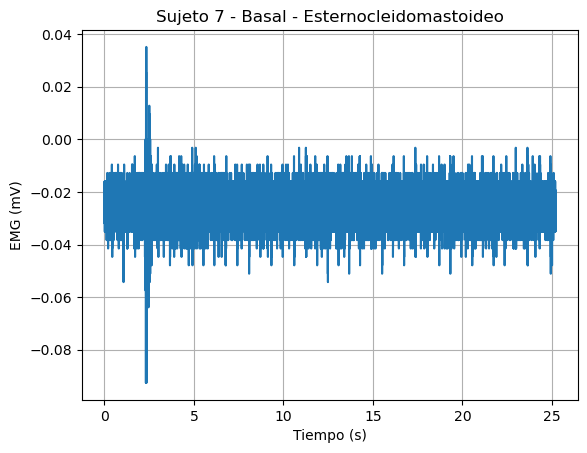

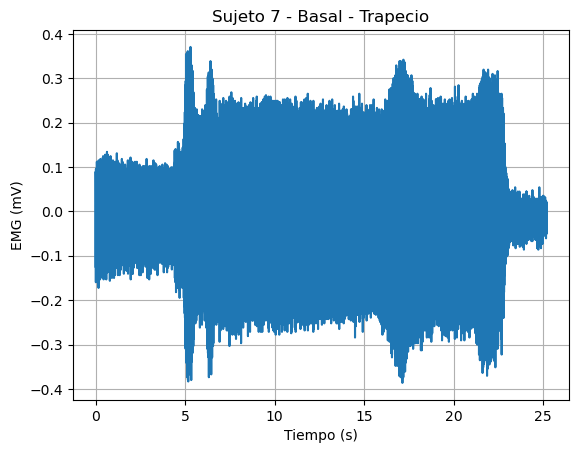

In [4]:
# Importar librerías
import numpy as np
import matplotlib.pyplot as plt

# Definir constantes
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_mochila.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
conversion_factor = 3.3 / (1024 * 1009)
skip_lines = 7

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para graficar la señal
def graficar_senal(senalmV, titulo):
    num_muestra = np.arange(len(senalmV))
    t = num_muestra / fs
    plt.plot(t, senalmV)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('EMG (mV)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
graficar_senal(senalmV_esternocleidomastoideo, 'Sujeto 7 - Basal - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
graficar_senal(senalmV_trapecio, 'Sujeto 7 - Basal - Trapecio')


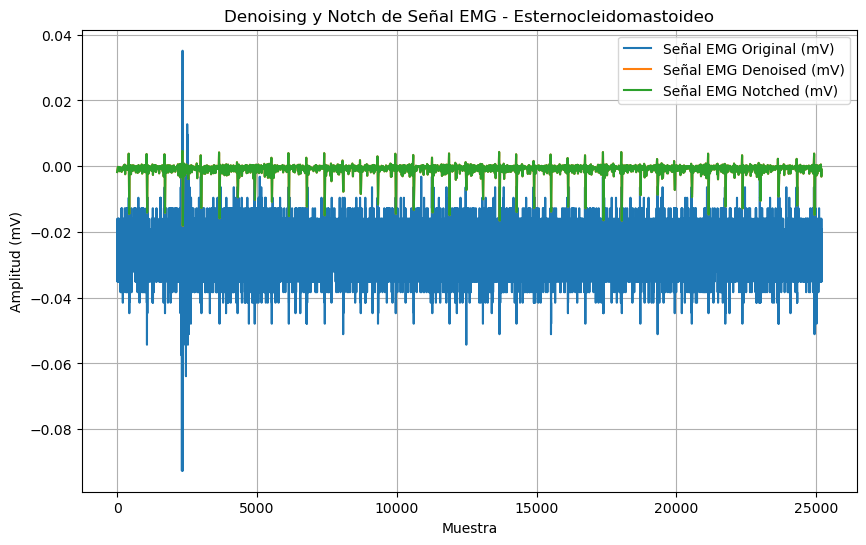

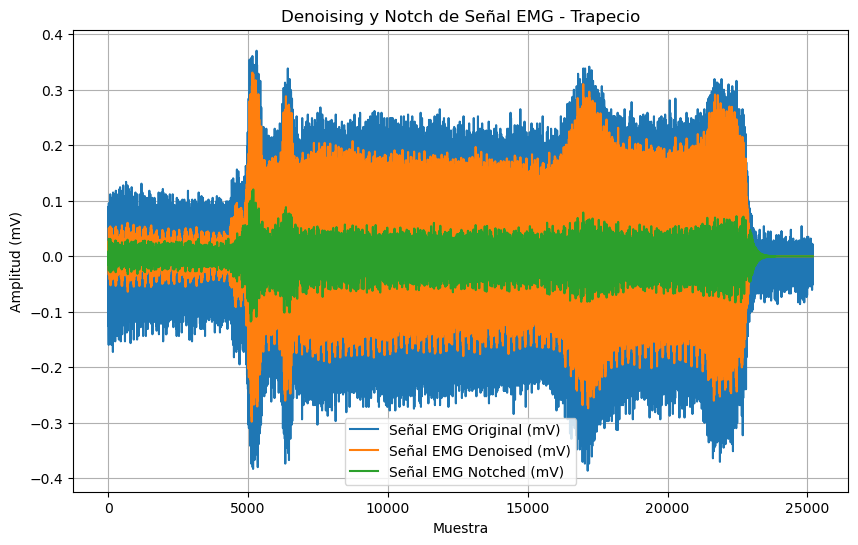

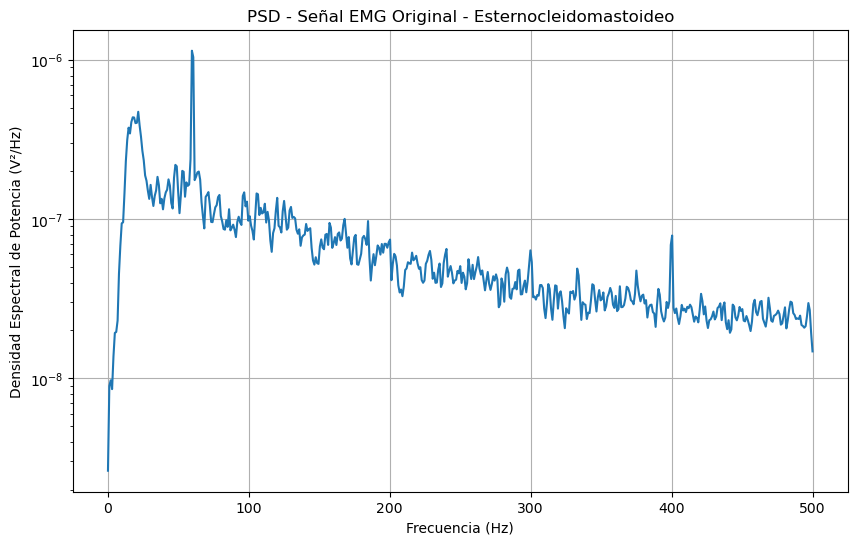

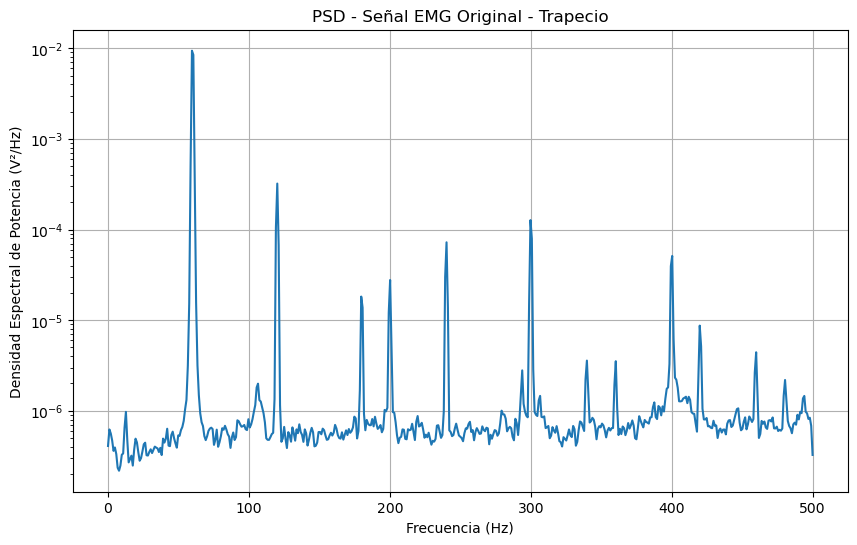

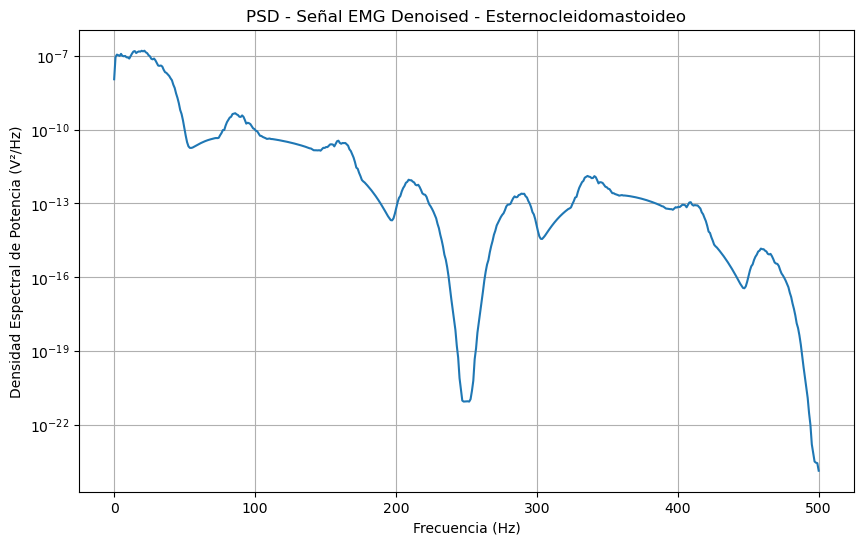

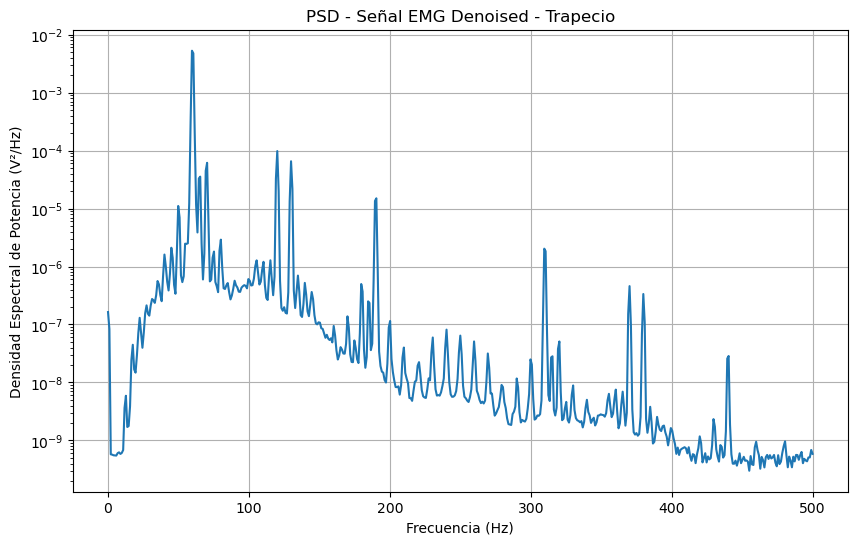

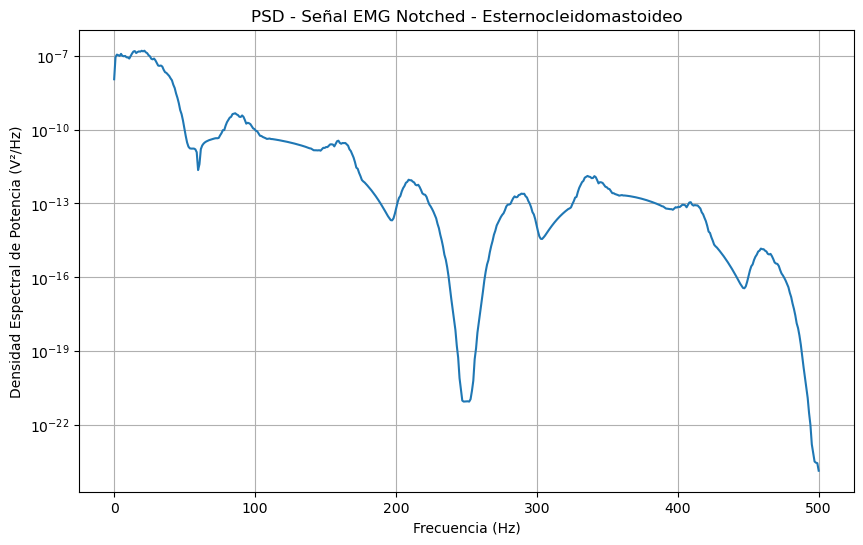

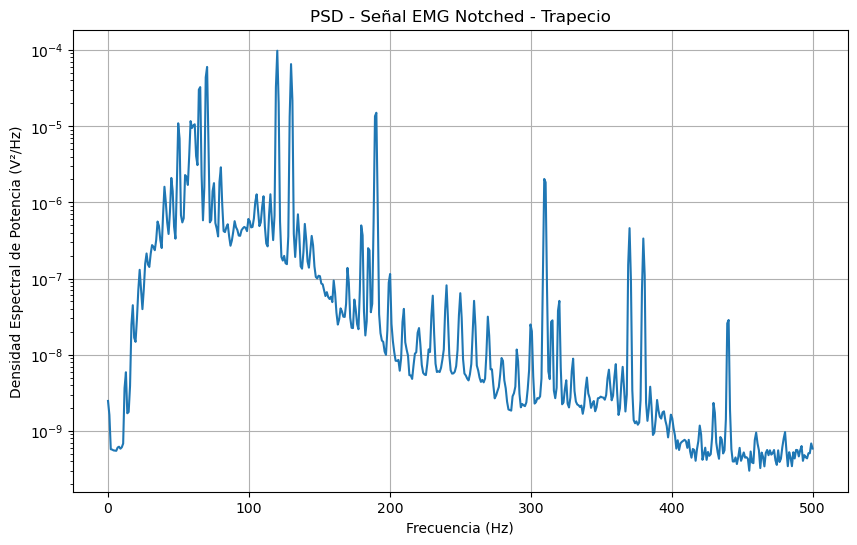

Se necesitaba filtro notch para esternocleidomastoideo: True
Se necesitaba filtro notch para trapecio: True


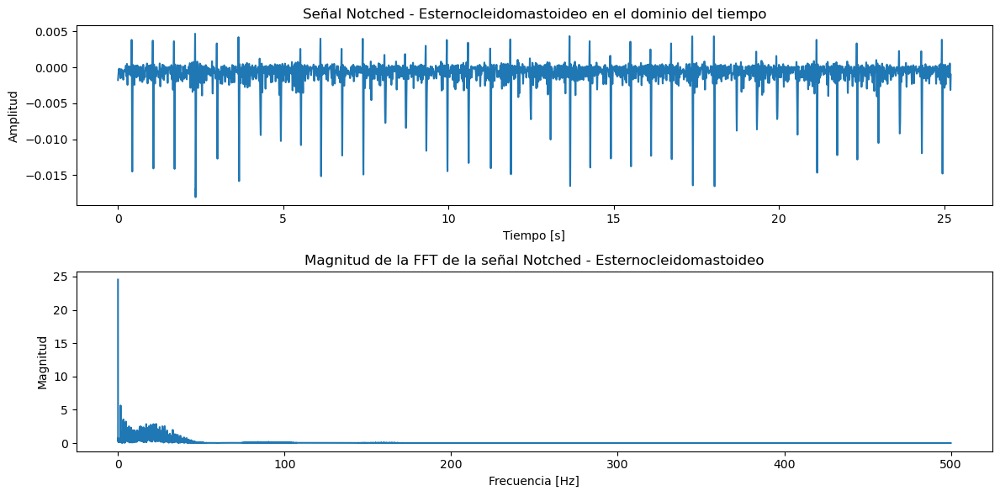

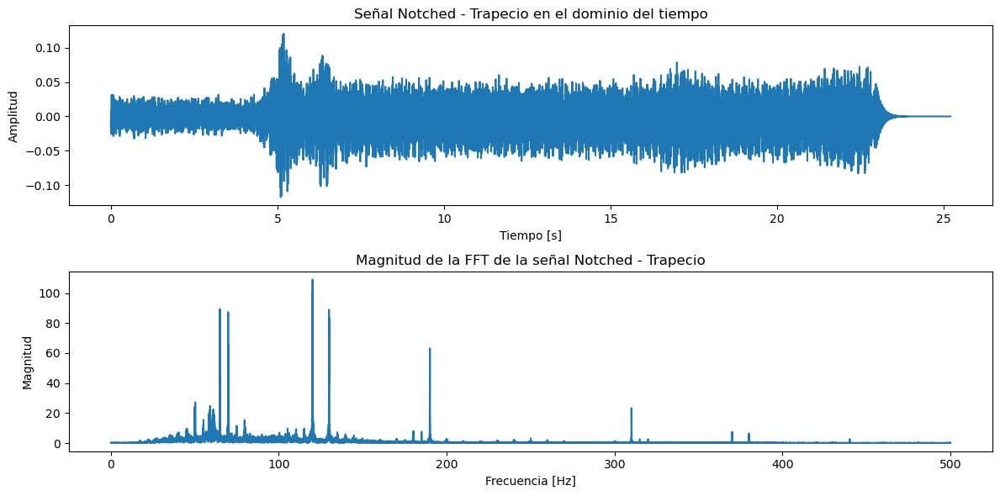

Maximum EMG - Esternocleidomastoideo: 0.00468015779907465
Minimum EMG - Esternocleidomastoideo: -0.018061218181379082
Average EMG - Esternocleidomastoideo: -0.0009739793346675886
Standard Deviation EMG - Esternocleidomastoideo: 0.0019031792953260681


Burst End Times - Esternocleidomastoideo: [ 0.74502957  1.38305489  2.02408033  2.67710625  3.31113141  3.9911584
  4.60218266  5.24620822  5.83223147  6.45725628  7.08328113  7.76330812
  8.19932542  8.31132987  8.96035563  9.61438158 10.29440857 10.90843294
 11.60746069 12.2174849  12.39249184 12.76150649 13.37253074 14.00255575
 14.60057948 15.21360381 15.82862822 16.43465227 17.05967708 17.71870323
 18.36672895 18.99375384 19.65077992 20.85082755 21.47385227 22.06487573
 22.67990014 23.28892431 23.92094939 24.61797706 24.97599127]
Maximum time - Esternocleidomastoideo: 0.5450216312760467
Minimum time - Esternocleidomastoideo: 0.020000793808295114
Average time - Esternocleidomastoideo: 0.4395784219671924
Standard Deviation time - Esternocleidomastoideo: 0.13013475298784744


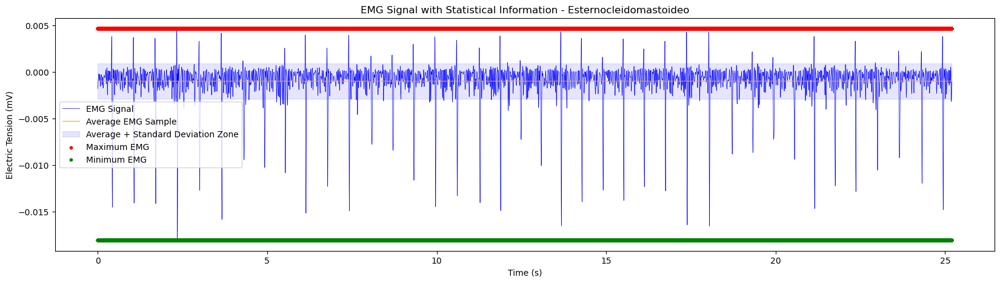

Características de la señal EMG:
  RMS: 0.002139551516900487
  Min: -0.06307778702786211
  Max: 0.011181777105753509
  Median: -2.070151670460654e-10
  Std Dev: 0.0021255067031831346
  MAV: 0.0002465518958076064
El valor RMS de la señal EMG - Esternocleidomastoideo es: 0.00213792590482396


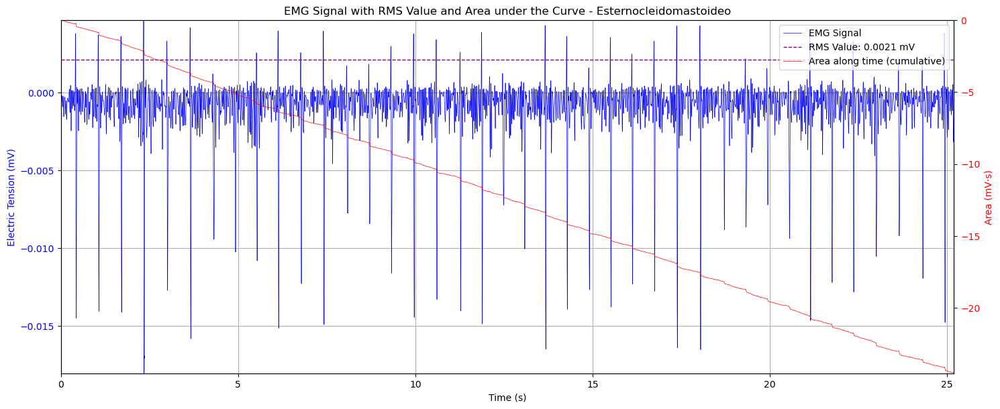

Frecuencia mediana (MDF) - Esternocleidomastoideo: 9.32687728210827 Hz
Frecuencia media (MNF) - Esternocleidomastoideo: 11.386292263248581 Hz
Maximum EMG - Trapecio: 0.12050420862318359
Minimum EMG - Trapecio: -0.1175380348754497
Average EMG - Trapecio: -1.3253327414263927e-05
Standard Deviation EMG - Trapecio: 0.023958853584032793


Burst End Times - Trapecio: [23.07391578]
Maximum time - Trapecio: 18.595738043262553
Minimum time - Trapecio: 18.595738043262553
Average time - Trapecio: 18.595738043262553
Standard Deviation time - Trapecio: 0.0


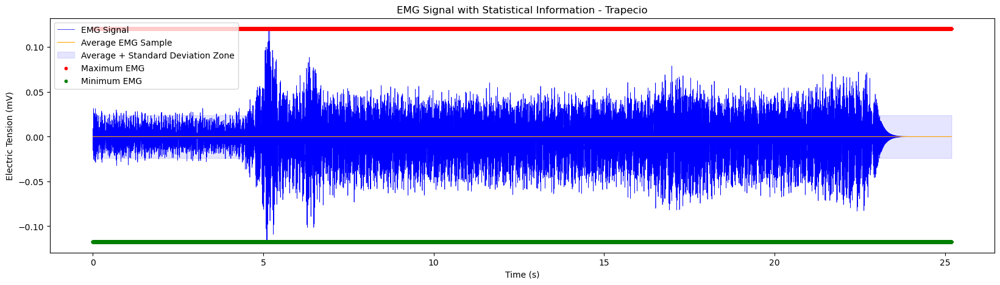

Características de la señal EMG:
  RMS: 0.02394832403520104
  Min: -0.25630947942395954
  Max: 0.16518317685229145
  Median: -4.80599660581949e-10
  Std Dev: 0.023947637426610022
  MAV: 0.01011361120550577
El valor RMS de la señal EMG - Trapecio es: 0.023958857249706395


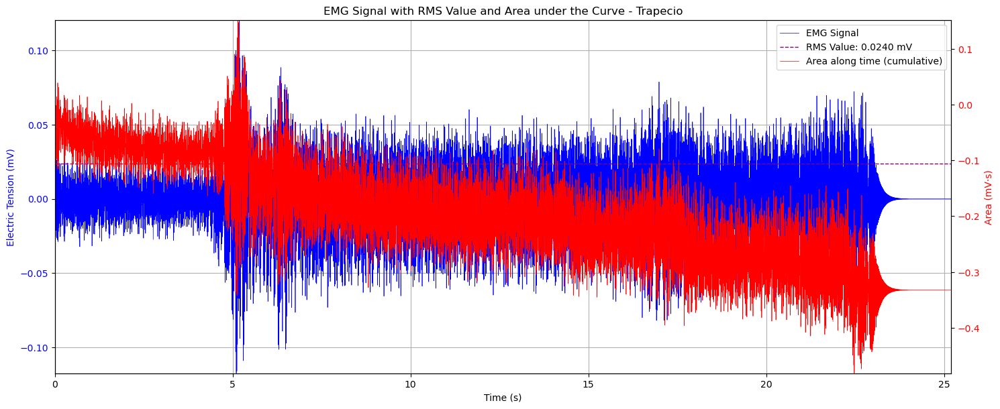

Frecuencia mediana (MDF) - Trapecio: 116.01047785362755 Hz
Frecuencia media (MNF) - Trapecio: 101.17517201230706 Hz


In [15]:

# Importar librerías
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt

# Definir constantes y parámetros
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_mochila.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para descomponer y denoising la señal usando transformada wavelet
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Función para aplicar filtro notch
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Función para graficar la señal EMG original y denoised
def graficar_senal(senalmV, emg_denoised, emg_notched, titulo):
    plt.figure(figsize=(10, 6))
    plt.plot(senalmV, label='Señal EMG Original (mV)')
    plt.plot(emg_denoised, label='Señal EMG Denoised (mV)')
    plt.plot(emg_notched, label='Señal EMG Notched (mV)')
    plt.xlabel('Muestra')
    plt.ylabel('Amplitud (mV)')
    plt.title(titulo)
    plt.legend()
    plt.grid(True)
    plt.show()

# Función para calcular y graficar la densidad espectral de potencia
def graficar_psd(senalmV, fs, titulo):
    f, Pxx = welch(senalmV, fs, nperseg=1024)
    plt.figure(figsize=(10, 6))
    plt.semilogy(f, Pxx)
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Densidad Espectral de Potencia (V²/Hz)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()
    return f, Pxx

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar, denoising y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
emg_denoised_esternocleidomastoideo = denoise_signal(senalmV_esternocleidomastoideo, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_esternocleidomastoideo = apply_notch_filter(emg_denoised_esternocleidomastoideo, f0, Q, fs)
graficar_senal(senalmV_esternocleidomastoideo, emg_denoised_esternocleidomastoideo, emg_notched_esternocleidomastoideo, 'Denoising y Notch de Señal EMG - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
emg_denoised_trapecio = denoise_signal(senalmV_trapecio, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_trapecio = apply_notch_filter(emg_denoised_trapecio, f0, Q, fs)
graficar_senal(senalmV_trapecio, emg_denoised_trapecio, emg_notched_trapecio, 'Denoising y Notch de Señal EMG - Trapecio')

# Graficar la densidad espectral de potencia de las señales originales
f_esternocleidomastoideo, Pxx_esternocleidomastoideo = graficar_psd(senalmV_esternocleidomastoideo, fs, 'PSD - Señal EMG Original - Esternocleidomastoideo')
f_trapecio, Pxx_trapecio = graficar_psd(senalmV_trapecio, fs, 'PSD - Señal EMG Original - Trapecio')

# Graficar la densidad espectral de potencia de las señales denoised
f_denoised_esternocleidomastoideo, Pxx_denoised_esternocleidomastoideo = graficar_psd(emg_denoised_esternocleidomastoideo, fs, 'PSD - Señal EMG Denoised - Esternocleidomastoideo')
f_denoised_trapecio, Pxx_denoised_trapecio = graficar_psd(emg_denoised_trapecio, fs, 'PSD - Señal EMG Denoised - Trapecio')

# Graficar la densidad espectral de potencia de las señales notched
f_notched_esternocleidomastoideo, Pxx_notched_esternocleidomastoideo = graficar_psd(emg_notched_esternocleidomastoideo, fs, 'PSD - Señal EMG Notched - Esternocleidomastoideo')
f_notched_trapecio, Pxx_notched_trapecio = graficar_psd(emg_notched_trapecio, fs, 'PSD - Señal EMG Notched - Trapecio')

# Determinar si se necesitaba el filtro notch
def check_notch_necessity(f, Pxx, f0):
    idx = np.where((f >= f0 - 1) & (f <= f0 + 1))[0]
    if np.any(Pxx[idx] > np.median(Pxx) * 10):  # Umbral arbitrario, ajustar según sea necesario
        return True
    return False

needed_notch_esternocleidomastoideo = check_notch_necessity(f_esternocleidomastoideo, Pxx_esternocleidomastoideo, f0)
needed_notch_trapecio = check_notch_necessity(f_trapecio, Pxx_trapecio, f0)

print(f"Se necesitaba filtro notch para esternocleidomastoideo: {needed_notch_esternocleidomastoideo}")
print(f"Se necesitaba filtro notch para trapecio: {needed_notch_trapecio}")

# Función para calcular y graficar la FFT de la señal
def graficar_fft(senal, fs, titulo):
    fft_result = np.fft.fft(senal)
    fft_freq = np.fft.fftfreq(len(senal), d=1/fs)
    
    # Solo mantener la mitad positiva del espectro
    positive_freq_idx = np.where(fft_freq >= 0)
    fft_freq = fft_freq[positive_freq_idx]
    fft_result = fft_result[positive_freq_idx]
    
    # Calcular la magnitud de la FFT
    fft_magnitude = np.abs(fft_result)
    
    # Graficar la señal y su FFT
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(np.arange(len(senal)) / fs, senal)
    plt.title(f'Señal {titulo} en el dominio del tiempo')
    plt.xlabel('Tiempo [s]')
    plt.ylabel('Amplitud')
    
    plt.subplot(2, 1, 2)
    plt.plot(fft_freq, fft_magnitude)
    plt.title(f'Magnitud de la FFT de la señal {titulo}')
    plt.xlabel('Frecuencia [Hz]')
    plt.ylabel('Magnitud')
    
    plt.tight_layout()
    plt.show()

# Calcular y graficar la FFT de las señales notched
graficar_fft(emg_notched_esternocleidomastoideo, fs, 'Notched - Esternocleidomastoideo')
graficar_fft(emg_notched_trapecio, fs, 'Notched - Trapecio')

# Existing imports and previous function definitions...
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt
import biosignalsnotebooks as bsnb
from scipy.integrate import cumtrapz

# Function to process, denoise, notch, and calculate statistics
def process_and_analyze_emg(signal, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, title):
    # Denoise the signal
    emg_denoised = denoise_signal(signal, wavelet, level, mode, threshold_method, threshold_value)
    # Apply notch filter
    emg_notched = apply_notch_filter(emg_denoised, f0, Q, fs)
    # Calculate EMG statistics
    max_sample_value, min_sample_value, avg_sample_value, std_sample_value = calculate_emg_statistics(emg_notched, title)
    # Detect muscle activations
    burst_begin, burst_end = detect_muscle_activations(emg_notched, fs)
    calculate_burst_statistics(burst_begin, burst_end, title)
    # Plot graphical and statistical information
    t = np.arange(len(emg_notched)) / fs
    bsnb.plot_emg_graphical_statistical(t, emg_notched, max_sample_value, min_sample_value, avg_sample_value, std_sample_value)
    # Plot the EMG signal with statistical information
    plot_emg_with_statistics(t, emg_notched, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title)
    # Perform wavelet decomposition and statistics
    wavelet_analysis(emg_notched, wavelet, level, title)
    # Plot RMS and area under the curve
    plot_rms_and_area(t, emg_notched, title)
    # Perform frequency analysis
    frequency_analysis(emg_notched, fs, title)

# Function to plot the EMG signal with statistical information
def plot_emg_with_statistics(time, smooth_signal, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title):
    # Ensure all statistical arrays match the length of the time array
    avg_sample_array = np.full_like(time, avg_sample_value)
    std_sample_array = np.full_like(time, std_sample_value)
    max_sample_array = np.full_like(time, max_sample_value)
    min_sample_array = np.full_like(time, min_sample_value)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(20, 5))

    # Plot the EMG signal
    ax.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)

    # Plot the average EMG signal
    ax.plot(time, avg_sample_array, label='Average EMG Sample', color='orange', linewidth=0.8)

    # Plot the standard deviation zone
    ax.fill_between(time, avg_sample_array - std_sample_array, avg_sample_array + std_sample_array, color='blue', alpha=0.1, label='Average + Standard Deviation Zone')

    # Plot maximum and minimum EMG values with smaller markers
    ax.scatter(time, max_sample_array, label='Maximum EMG', color='red', s=10, zorder=3)  # Marker size set to 10
    ax.scatter(time, min_sample_array, label='Minimum EMG', color='green', s=10, zorder=3)  # Marker size set to 10

    # Set labels and title
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Electric Tension (mV)')
    ax.set_title(f'EMG Signal with Statistical Information - {title}')

    # Add legend
    ax.legend()

    # Display the plot
    plt.show()

# Function to perform wavelet decomposition and calculate statistics
def wavelet_analysis(signal, wavelet, level, title):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    all_coeffs = np.concatenate(coeffs)
    rms_total = np.sqrt(np.mean(np.square(all_coeffs)))
    min_total = np.min(all_coeffs)
    max_total = np.max(all_coeffs)
    median_total = np.median(all_coeffs)
    std_dev_total = np.std(all_coeffs)
    mav_total = np.mean(np.abs(all_coeffs))
    print("Características de la señal EMG:")
    print(f"  RMS: {rms_total}")
    print(f"  Min: {min_total}")
    print(f"  Max: {max_total}")
    print(f"  Median: {median_total}")
    print(f"  Std Dev: {std_dev_total}")
    print(f"  MAV: {mav_total}")

# Function to calculate RMS and plot the area under the curve
def plot_rms_and_area(time, smooth_signal, title):
    rms_value = np.sqrt(np.mean(np.square(smooth_signal)))
    print(f"El valor RMS de la señal EMG - {title} es: {rms_value}")
    area = cumtrapz(smooth_signal, initial=0)

    fig, ax1 = plt.subplots(figsize=(15, 6))
    ax1.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Electric Tension (mV)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')

    ax2 = ax1.twinx()
    ax2.plot(time, area, label='Area along time (cumulative)', color='red', linewidth=0.5)
    ax2.set_ylabel('Area (mV·s)', color='red')
    ax2.tick_params(axis='y', labelcolor='red')

    ax1.axhline(y=rms_value, color='purple', linestyle='--', linewidth=1, label=f'RMS Value: {rms_value:.4f} mV')

    fig.tight_layout()
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')

    ax1.grid(True)
    ax1.set_xlim([0, max(time)])
    ax1.set_ylim([min(smooth_signal), max(smooth_signal)])
    ax2.set_ylim([min(area), max(area)])
    plt.title(f'EMG Signal with RMS Value and Area under the Curve - {title}')
    plt.show()

# Function to perform frequency analysis
def frequency_analysis(signal, fs, title):
    N = len(signal)
    freqs = np.fft.rfftfreq(N, 1/fs)
    fft_magnitude = np.abs(np.fft.rfft(signal))

    power_spectrum = fft_magnitude**2
    cumulative_power = np.cumsum(power_spectrum)
    total_power = cumulative_power[-1]
    median_freq_index = np.where(cumulative_power >= total_power / 2)[0][0]
    MDF = freqs[median_freq_index]
    print(f"Frecuencia mediana (MDF) - {title}: {MDF} Hz")

    MNF = np.sum(freqs * power_spectrum) / np.sum(power_spectrum)
    print(f"Frecuencia media (MNF) - {title}: {MNF} Hz")

# Function to detect muscle activations
def detect_muscle_activations(signal, fs, smooth_level=22, threshold_level=10):
    burst_begin, burst_end = bsnb.detect_emg_activations(signal, fs, smooth_level=smooth_level, threshold_level=threshold_level, time_units=True, plot_result=True)[:2]
    return burst_begin, burst_end

# Function to calculate and print burst durations and statistics
def calculate_burst_statistics(burst_begin, burst_end, title):
    bursts_time = burst_end - burst_begin
    print(f"Burst End Times - {title}: {burst_end}")
    
    max_time = np.max(bursts_time)
    min_time = np.min(bursts_time)
    avg_time = np.average(bursts_time)
    std_time = np.std(bursts_time)
    
    print(f"Maximum time - {title}: {max_time}")
    print(f"Minimum time - {title}: {min_time}")
    print(f"Average time - {title}: {avg_time}")
    print(f"Standard Deviation time - {title}: {std_time}")

# Function to calculate and return EMG signal statistics
def calculate_emg_statistics(signal, title):
    max_sample_value = np.max(signal)
    min_sample_value = np.min(signal)
    avg_sample_value = np.average(signal)
    std_sample_value = np.std(signal)
    
    print(f"Maximum EMG - {title}: {max_sample_value}")
    print(f"Minimum EMG - {title}: {min_sample_value}")
    print(f"Average EMG - {title}: {avg_sample_value}")
    print(f"Standard Deviation EMG - {title}: {std_sample_value}")
    
    return max_sample_value, min_sample_value, avg_sample_value, std_sample_value

# Function to denoise the signal using wavelet transform
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Function to apply a notch filter
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Main code to process both signals
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_mochila.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y analizar señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
process_and_analyze_emg(senalmV_esternocleidomastoideo, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Esternocleidomastoideo")

senalmV_trapecio = procesar_senal(datos, 11)
process_and_analyze_emg(senalmV_trapecio, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Trapecio")

JUAN_COMPUTADORA

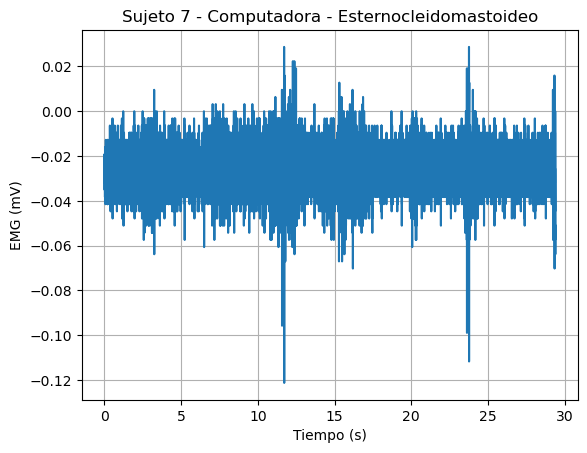

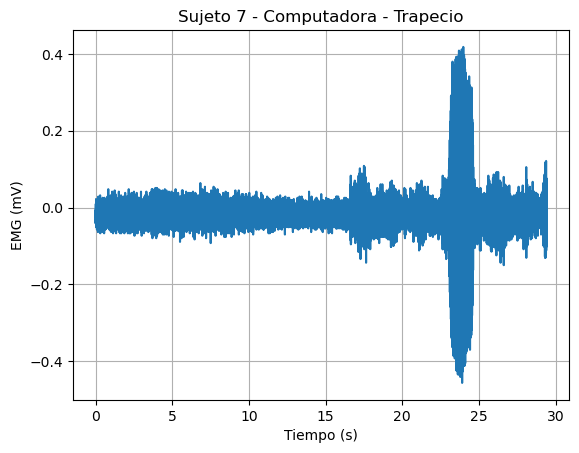

In [6]:
# Importar librerías
import numpy as np
import matplotlib.pyplot as plt

# Definir constantes
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_compu.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
conversion_factor = 3.3 / (1024 * 1009)
skip_lines = 7

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para graficar la señal
def graficar_senal(senalmV, titulo):
    num_muestra = np.arange(len(senalmV))
    t = num_muestra / fs
    plt.plot(t, senalmV)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('EMG (mV)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
graficar_senal(senalmV_esternocleidomastoideo, 'Sujeto 7 - Computadora - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
graficar_senal(senalmV_trapecio, 'Sujeto 7 - Computadora - Trapecio')

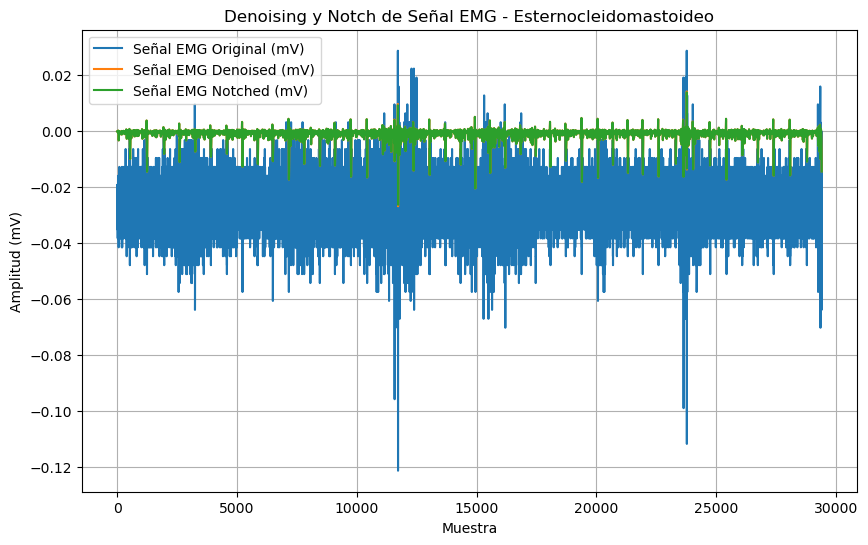

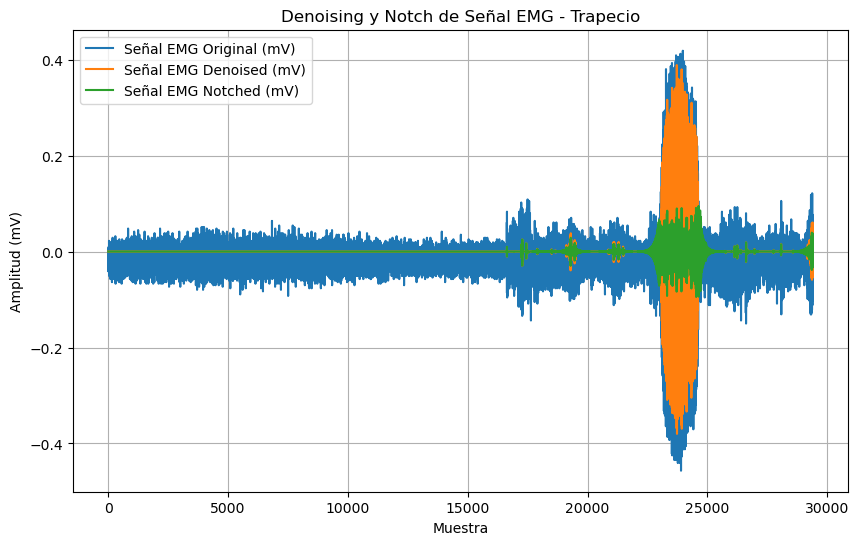

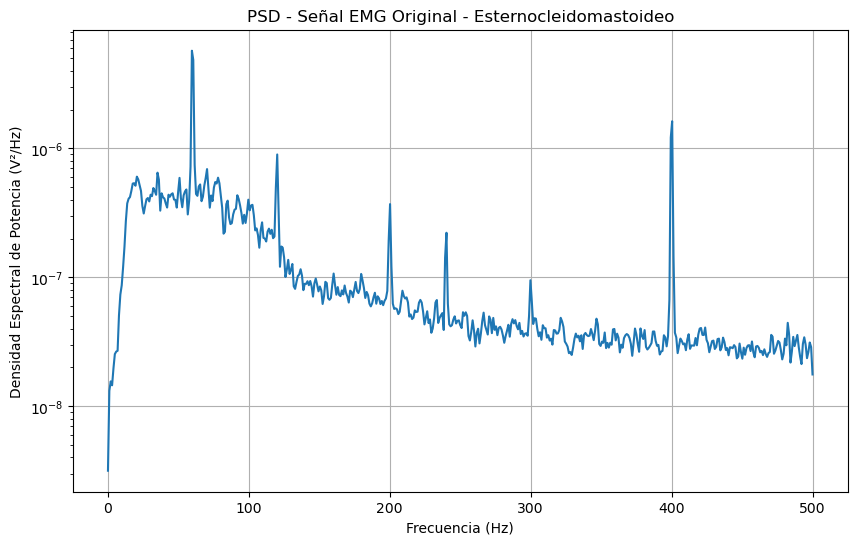

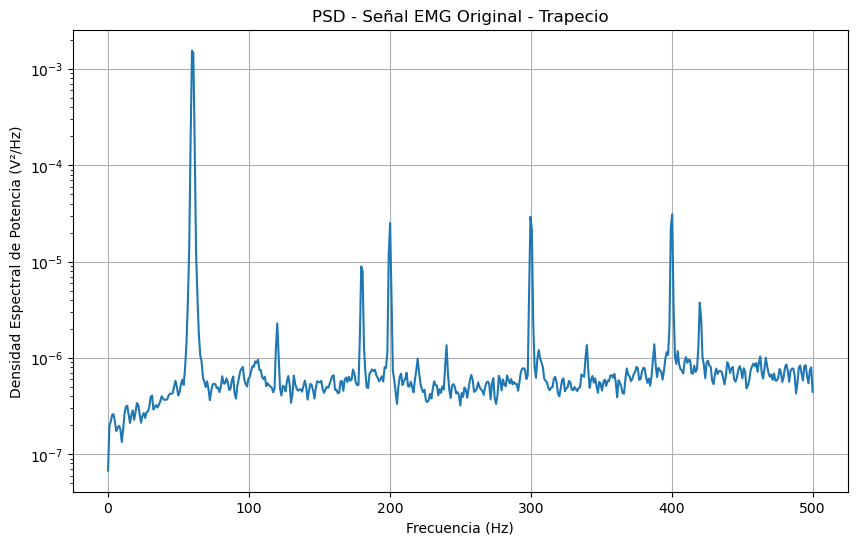

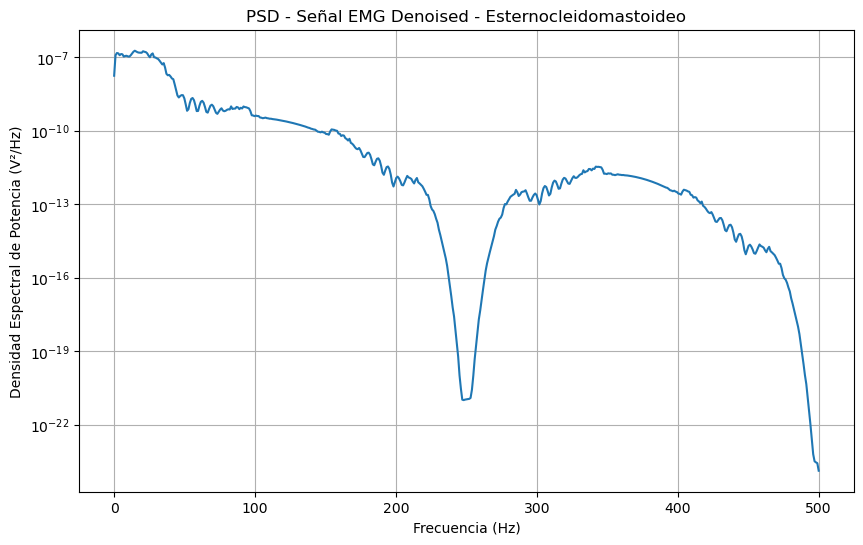

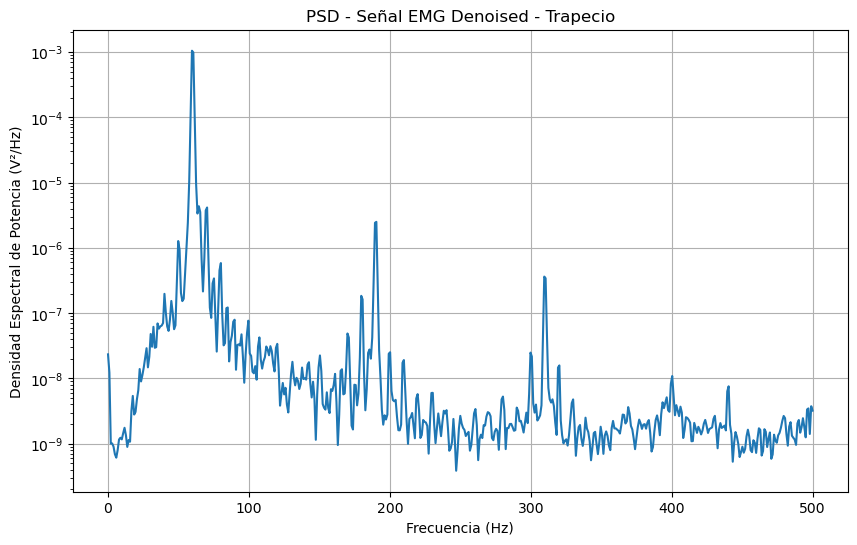

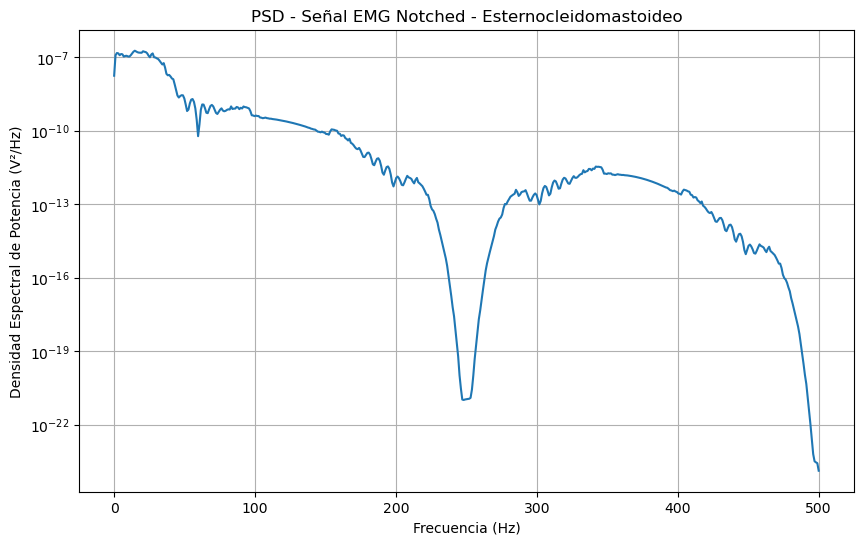

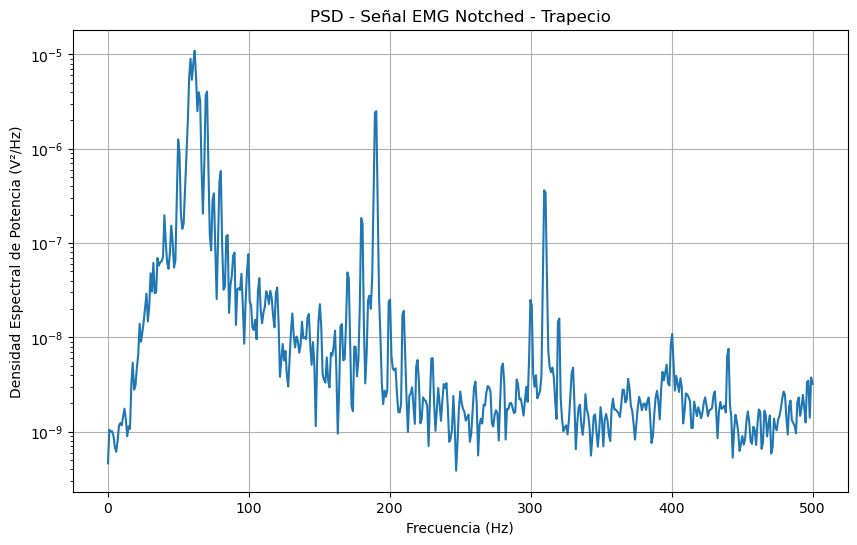

Se necesitaba filtro notch para esternocleidomastoideo: True
Se necesitaba filtro notch para trapecio: True


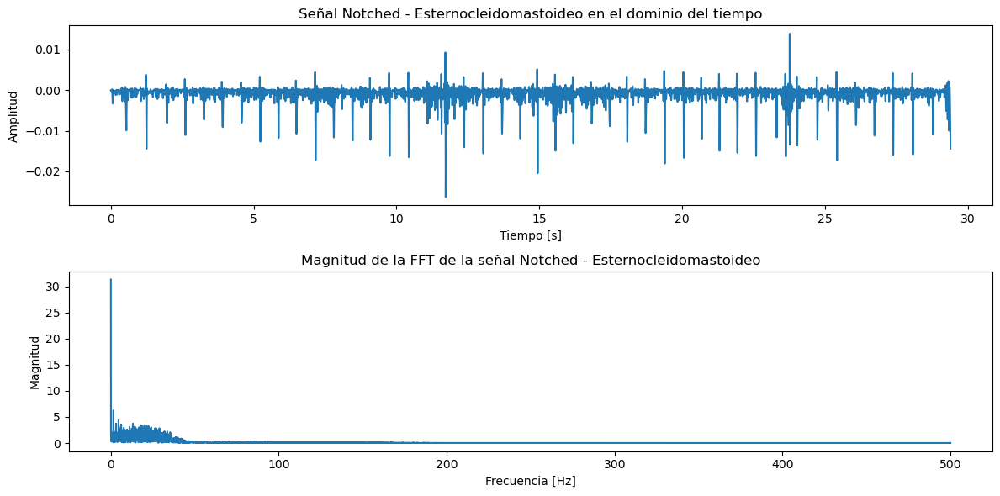

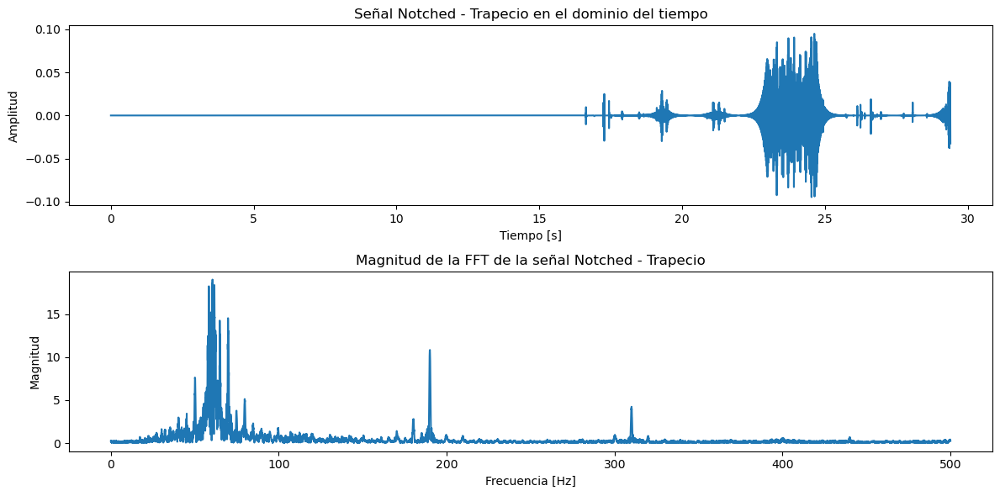

Maximum EMG - Esternocleidomastoideo: 0.013869784976843099
Minimum EMG - Esternocleidomastoideo: -0.02631939483465422
Average EMG - Esternocleidomastoideo: -0.0010659622285203506
Standard Deviation EMG - Esternocleidomastoideo: 0.002125912182145678


Burst End Times - Esternocleidomastoideo: [ 7.43625297  9.99534002 10.67536316 12.04140963 12.61342909 13.27045144
 15.22551795 15.87454002 16.16754999 19.64966845 20.32169131 22.8317767
 24.09081953 25.68587379 27.63193999 28.30996305]
Maximum time - Esternocleidomastoideo: 0.7400251743493804
Minimum time - Esternocleidomastoideo: 0.0870029596870232
Average time - Esternocleidomastoideo: 0.4056387991154958
Standard Deviation time - Esternocleidomastoideo: 0.13451799314625432


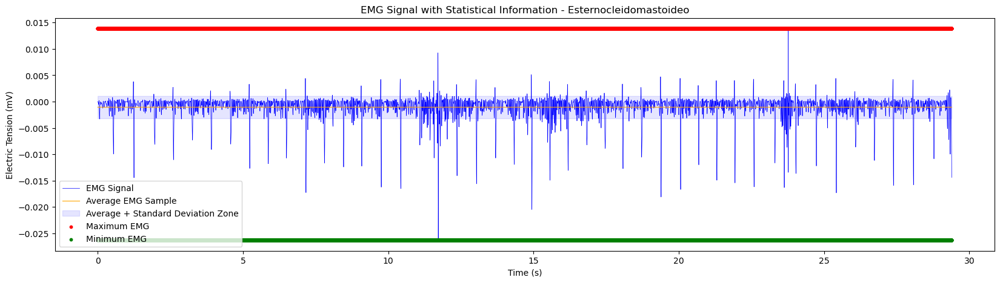

Características de la señal EMG:
  RMS: 0.002447296487643849
  Min: -0.07709284474523558
  Max: 0.032450259296732405
  Median: -2.234116939782462e-10
  MAV: 0.00028015942877440074
  Std Dev: 0.002431955244933126
El valor RMS de la señal EMG - Esternocleidomastoideo es: 0.0023781879822308985


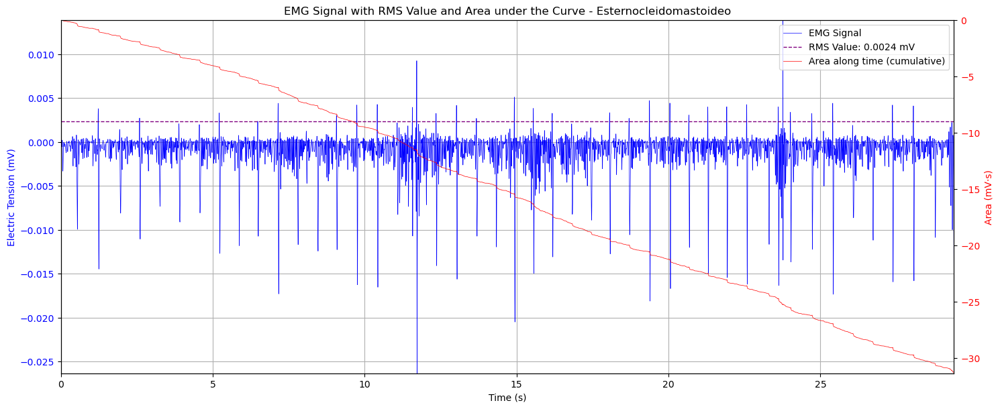

Frecuencia mediana (MDF) - Esternocleidomastoideo: 9.389032521431487 Hz
Frecuencia media (MNF) - Esternocleidomastoideo: 12.36996622618501 Hz
Maximum EMG - Trapecio: 0.09492595001416032
Minimum EMG - Trapecio: -0.09477231353223431
Average EMG - Trapecio: -8.403476810973409e-06
Standard Deviation EMG - Trapecio: 0.008895397565480414


Burst End Times - Trapecio: [25.01085082]
Maximum time - Trapecio: 2.2420762714747404
Minimum time - Trapecio: 2.2420762714747404
Average time - Trapecio: 2.2420762714747404
Standard Deviation time - Trapecio: 0.0


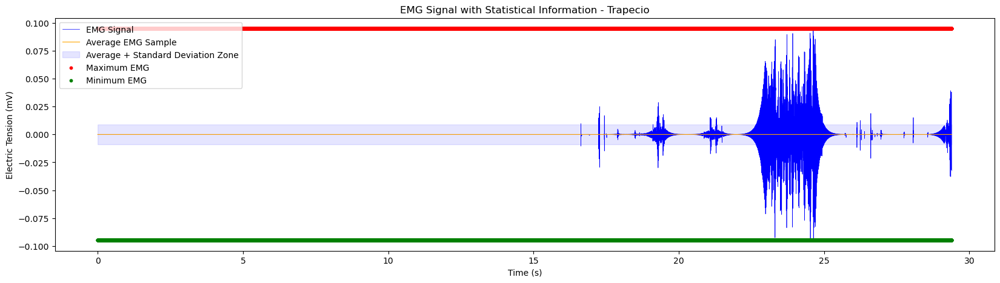

Características de la señal EMG:
  RMS: 0.008947146407566022
  Min: -0.1712848580458563
  Max: 0.23154864273313902
  Median: 1.767461439688863e-56
  MAV: 0.0012602322122205016
  Std Dev: 0.008947033982665501
El valor RMS de la señal EMG - Trapecio es: 0.00889540153485931


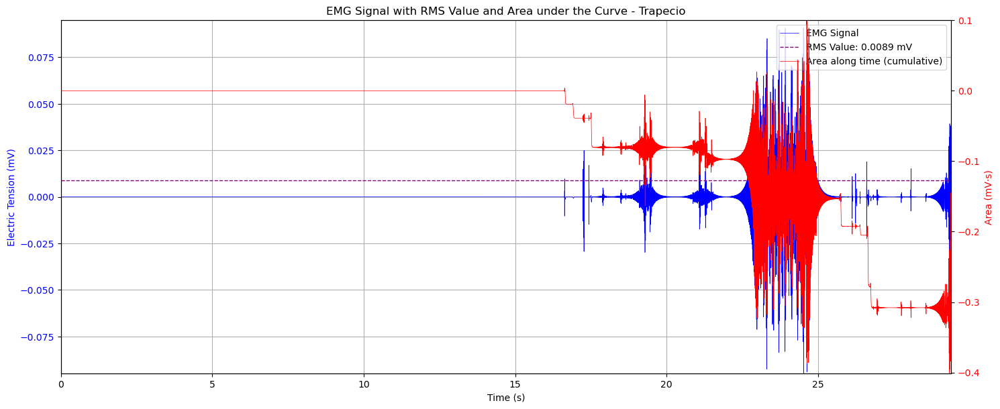

Frecuencia mediana (MDF) - Trapecio: 61.470948428357595 Hz
Frecuencia media (MNF) - Trapecio: 77.05432321070369 Hz


In [17]:
# Importar librerías
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt

# Definir constantes y parámetros
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_compu.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para descomponer y denoising la señal usando transformada wavelet
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Función para aplicar filtro notch
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Función para graficar la señal EMG original y denoised
def graficar_senal(senalmV, emg_denoised, emg_notched, titulo):
    plt.figure(figsize=(10, 6))
    plt.plot(senalmV, label='Señal EMG Original (mV)')
    plt.plot(emg_denoised, label='Señal EMG Denoised (mV)')
    plt.plot(emg_notched, label='Señal EMG Notched (mV)')
    plt.xlabel('Muestra')
    plt.ylabel('Amplitud (mV)')
    plt.title(titulo)
    plt.legend()
    plt.grid(True)
    plt.show()

# Función para calcular y graficar la densidad espectral de potencia
def graficar_psd(senalmV, fs, titulo):
    f, Pxx = welch(senalmV, fs, nperseg=1024)
    plt.figure(figsize=(10, 6))
    plt.semilogy(f, Pxx)
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Densidad Espectral de Potencia (V²/Hz)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()
    return f, Pxx

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar, denoising y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
emg_denoised_esternocleidomastoideo = denoise_signal(senalmV_esternocleidomastoideo, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_esternocleidomastoideo = apply_notch_filter(emg_denoised_esternocleidomastoideo, f0, Q, fs)
graficar_senal(senalmV_esternocleidomastoideo, emg_denoised_esternocleidomastoideo, emg_notched_esternocleidomastoideo, 'Denoising y Notch de Señal EMG - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
emg_denoised_trapecio = denoise_signal(senalmV_trapecio, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_trapecio = apply_notch_filter(emg_denoised_trapecio, f0, Q, fs)
graficar_senal(senalmV_trapecio, emg_denoised_trapecio, emg_notched_trapecio, 'Denoising y Notch de Señal EMG - Trapecio')

# Graficar la densidad espectral de potencia de las señales originales
f_esternocleidomastoideo, Pxx_esternocleidomastoideo = graficar_psd(senalmV_esternocleidomastoideo, fs, 'PSD - Señal EMG Original - Esternocleidomastoideo')
f_trapecio, Pxx_trapecio = graficar_psd(senalmV_trapecio, fs, 'PSD - Señal EMG Original - Trapecio')

# Graficar la densidad espectral de potencia de las señales denoised
f_denoised_esternocleidomastoideo, Pxx_denoised_esternocleidomastoideo = graficar_psd(emg_denoised_esternocleidomastoideo, fs, 'PSD - Señal EMG Denoised - Esternocleidomastoideo')
f_denoised_trapecio, Pxx_denoised_trapecio = graficar_psd(emg_denoised_trapecio, fs, 'PSD - Señal EMG Denoised - Trapecio')

# Graficar la densidad espectral de potencia de las señales notched
f_notched_esternocleidomastoideo, Pxx_notched_esternocleidomastoideo = graficar_psd(emg_notched_esternocleidomastoideo, fs, 'PSD - Señal EMG Notched - Esternocleidomastoideo')
f_notched_trapecio, Pxx_notched_trapecio = graficar_psd(emg_notched_trapecio, fs, 'PSD - Señal EMG Notched - Trapecio')

# Determinar si se necesitaba el filtro notch
def check_notch_necessity(f, Pxx, f0):
    idx = np.where((f >= f0 - 1) & (f <= f0 + 1))[0]
    if np.any(Pxx[idx] > np.median(Pxx) * 10):  # Umbral arbitrario, ajustar según sea necesario
        return True
    return False

needed_notch_esternocleidomastoideo = check_notch_necessity(f_esternocleidomastoideo, Pxx_esternocleidomastoideo, f0)
needed_notch_trapecio = check_notch_necessity(f_trapecio, Pxx_trapecio, f0)

print(f"Se necesitaba filtro notch para esternocleidomastoideo: {needed_notch_esternocleidomastoideo}")
print(f"Se necesitaba filtro notch para trapecio: {needed_notch_trapecio}")

# Función para calcular y graficar la FFT de la señal
def graficar_fft(senal, fs, titulo):
    fft_result = np.fft.fft(senal)
    fft_freq = np.fft.fftfreq(len(senal), d=1/fs)
    
    # Solo mantener la mitad positiva del espectro
    positive_freq_idx = np.where(fft_freq >= 0)
    fft_freq = fft_freq[positive_freq_idx]
    fft_result = fft_result[positive_freq_idx]
    
    # Calcular la magnitud de la FFT
    fft_magnitude = np.abs(fft_result)
    
    # Graficar la señal y su FFT
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(np.arange(len(senal)) / fs, senal)
    plt.title(f'Señal {titulo} en el dominio del tiempo')
    plt.xlabel('Tiempo [s]')
    plt.ylabel('Amplitud')
    
    plt.subplot(2, 1, 2)
    plt.plot(fft_freq, fft_magnitude)
    plt.title(f'Magnitud de la FFT de la señal {titulo}')
    plt.xlabel('Frecuencia [Hz]')
    plt.ylabel('Magnitud')
    
    plt.tight_layout()
    plt.show()

# Calcular y graficar la FFT de las señales notched
graficar_fft(emg_notched_esternocleidomastoideo, fs, 'Notched - Esternocleidomastoideo')
graficar_fft(emg_notched_trapecio, fs, 'Notched - Trapecio')

# Existing imports and previous function definitions...
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt
import biosignalsnotebooks as bsnb
from scipy.integrate import cumtrapz

# Function to process, denoise, notch, and calculate statistics
def process_and_analyze_emg(signal, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, title):
    # Denoise the signal
    emg_denoised = denoise_signal(signal, wavelet, level, mode, threshold_method, threshold_value)
    # Apply notch filter
    emg_notched = apply_notch_filter(emg_denoised, f0, Q, fs)
    # Calculate EMG statistics
    max_sample_value, min_sample_value, avg_sample_value, std_sample_value = calculate_emg_statistics(emg_notched, title)
    # Detect muscle activations
    burst_begin, burst_end = detect_muscle_activations(emg_notched, fs)
    calculate_burst_statistics(burst_begin, burst_end, title)
    # Plot graphical and statistical information
    t = np.arange(len(emg_notched)) / fs
    bsnb.plot_emg_graphical_statistical(t, emg_notched, max_sample_value, min_sample_value, avg_sample_value, std_sample_value)
    # Plot the EMG signal with statistical information
    plot_emg_with_statistics(t, emg_notched, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title)
    # Perform wavelet decomposition and statistics
    wavelet_analysis(emg_notched, wavelet, level, title)
    # Plot RMS and area under the curve
    plot_rms_and_area(t, emg_notched, title)
    # Perform frequency analysis
    frequency_analysis(emg_notched, fs, title)

# Function to plot the EMG signal with statistical information
def plot_emg_with_statistics(time, smooth_signal, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title):
    # Ensure all statistical arrays match the length of the time array
    avg_sample_array = np.full_like(time, avg_sample_value)
    std_sample_array = np.full_like(time, std_sample_value)
    max_sample_array = np.full_like(time, max_sample_value)
    min_sample_array = np.full_like(time, min_sample_value)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(20, 5))

    # Plot the EMG signal
    ax.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)

    # Plot the average EMG signal
    ax.plot(time, avg_sample_array, label='Average EMG Sample', color='orange', linewidth=0.8)

    # Plot the standard deviation zone
    ax.fill_between(time, avg_sample_array - std_sample_array, avg_sample_array + std_sample_array, color='blue', alpha=0.1, label='Average + Standard Deviation Zone')

    # Plot maximum and minimum EMG values with smaller markers
    ax.scatter(time, max_sample_array, label='Maximum EMG', color='red', s=10, zorder=3)  # Marker size set to 10
    ax.scatter(time, min_sample_array, label='Minimum EMG', color='green', s=10, zorder=3)  # Marker size set to 10

    # Set labels and title
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Electric Tension (mV)')
    ax.set_title(f'EMG Signal with Statistical Information - {title}')

    # Add legend
    ax.legend()

    # Display the plot
    plt.show()

# Function to perform wavelet decomposition and calculate statistics
def wavelet_analysis(signal, wavelet, level, title):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    all_coeffs = np.concatenate(coeffs)
    rms_total = np.sqrt(np.mean(np.square(all_coeffs)))
    min_total = np.min(all_coeffs)
    max_total = np.max(all_coeffs)
    median_total = np.median(all_coeffs)
    std_dev_total = np.std(all_coeffs)
    mav_total = np.mean(np.abs(all_coeffs))
    print("Características de la señal EMG:")
    print(f"  RMS: {rms_total}")
    print(f"  Min: {min_total}")
    print(f"  Max: {max_total}")
    print(f"  Median: {median_total}")
    print(f"  MAV: {mav_total}")
    print(f"  Std Dev: {std_dev_total}")

# Function to calculate RMS and plot the area under the curve
def plot_rms_and_area(time, smooth_signal, title):
    rms_value = np.sqrt(np.mean(np.square(smooth_signal)))
    print(f"El valor RMS de la señal EMG - {title} es: {rms_value}")
    area = cumtrapz(smooth_signal, initial=0)

    fig, ax1 = plt.subplots(figsize=(15, 6))
    ax1.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Electric Tension (mV)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')

    ax2 = ax1.twinx()
    ax2.plot(time, area, label='Area along time (cumulative)', color='red', linewidth=0.5)
    ax2.set_ylabel('Area (mV·s)', color='red')
    ax2.tick_params(axis='y', labelcolor='red')

    ax1.axhline(y=rms_value, color='purple', linestyle='--', linewidth=1, label=f'RMS Value: {rms_value:.4f} mV')

    fig.tight_layout()
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')

    ax1.grid(True)
    ax1.set_xlim([0, max(time)])
    ax1.set_ylim([min(smooth_signal), max(smooth_signal)])
    ax2.set_ylim([min(area), max(area)])
    plt.title(f'EMG Signal with RMS Value and Area under the Curve - {title}')
    plt.show()

# Function to perform frequency analysis
def frequency_analysis(signal, fs, title):
    N = len(signal)
    freqs = np.fft.rfftfreq(N, 1/fs)
    fft_magnitude = np.abs(np.fft.rfft(signal))

    power_spectrum = fft_magnitude**2
    cumulative_power = np.cumsum(power_spectrum)
    total_power = cumulative_power[-1]
    median_freq_index = np.where(cumulative_power >= total_power / 2)[0][0]
    MDF = freqs[median_freq_index]
    print(f"Frecuencia mediana (MDF) - {title}: {MDF} Hz")

    MNF = np.sum(freqs * power_spectrum) / np.sum(power_spectrum)
    print(f"Frecuencia media (MNF) - {title}: {MNF} Hz")

# Function to detect muscle activations
def detect_muscle_activations(signal, fs, smooth_level=22, threshold_level=10):
    burst_begin, burst_end = bsnb.detect_emg_activations(signal, fs, smooth_level=smooth_level, threshold_level=threshold_level, time_units=True, plot_result=True)[:2]
    return burst_begin, burst_end

# Function to calculate and print burst durations and statistics
def calculate_burst_statistics(burst_begin, burst_end, title):
    bursts_time = burst_end - burst_begin
    print(f"Burst End Times - {title}: {burst_end}")
    
    max_time = np.max(bursts_time)
    min_time = np.min(bursts_time)
    avg_time = np.average(bursts_time)
    std_time = np.std(bursts_time)
    
    print(f"Maximum time - {title}: {max_time}")
    print(f"Minimum time - {title}: {min_time}")
    print(f"Average time - {title}: {avg_time}")
    print(f"Standard Deviation time - {title}: {std_time}")

# Function to calculate and return EMG signal statistics
def calculate_emg_statistics(signal, title):
    max_sample_value = np.max(signal)
    min_sample_value = np.min(signal)
    avg_sample_value = np.average(signal)
    std_sample_value = np.std(signal)
    
    print(f"Maximum EMG - {title}: {max_sample_value}")
    print(f"Minimum EMG - {title}: {min_sample_value}")
    print(f"Average EMG - {title}: {avg_sample_value}")
    print(f"Standard Deviation EMG - {title}: {std_sample_value}")
    
    return max_sample_value, min_sample_value, avg_sample_value, std_sample_value

# Function to denoise the signal using wavelet transform
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Function to apply a notch filter
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Main code to process both signals
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_compu.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y analizar señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
process_and_analyze_emg(senalmV_esternocleidomastoideo, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Esternocleidomastoideo")

senalmV_trapecio = procesar_senal(datos, 11)
process_and_analyze_emg(senalmV_trapecio, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Trapecio")

Juan Banda

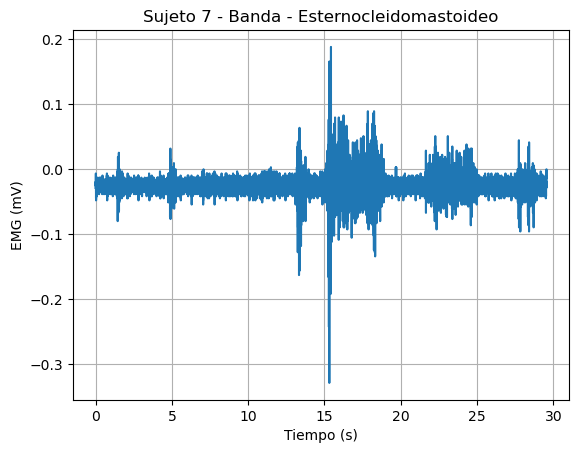

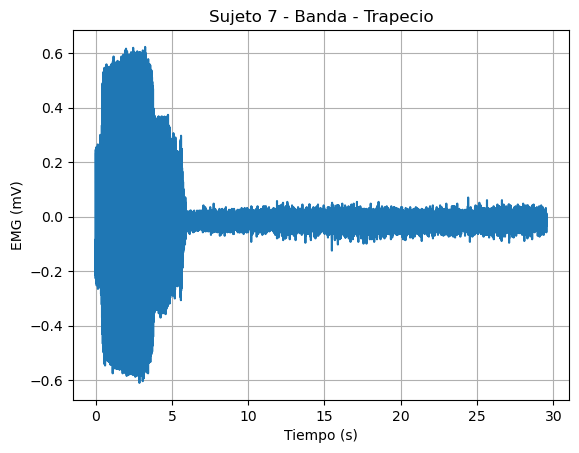

In [8]:
# Importar librerías
import numpy as np
import matplotlib.pyplot as plt

# Definir constantes
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_banda.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
conversion_factor = 3.3 / (1024 * 1009)
skip_lines = 7

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para graficar la señal
def graficar_senal(senalmV, titulo):
    num_muestra = np.arange(len(senalmV))
    t = num_muestra / fs
    plt.plot(t, senalmV)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('EMG (mV)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
graficar_senal(senalmV_esternocleidomastoideo, 'Sujeto 7 - Banda - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
graficar_senal(senalmV_trapecio, 'Sujeto 7 - Banda - Trapecio')

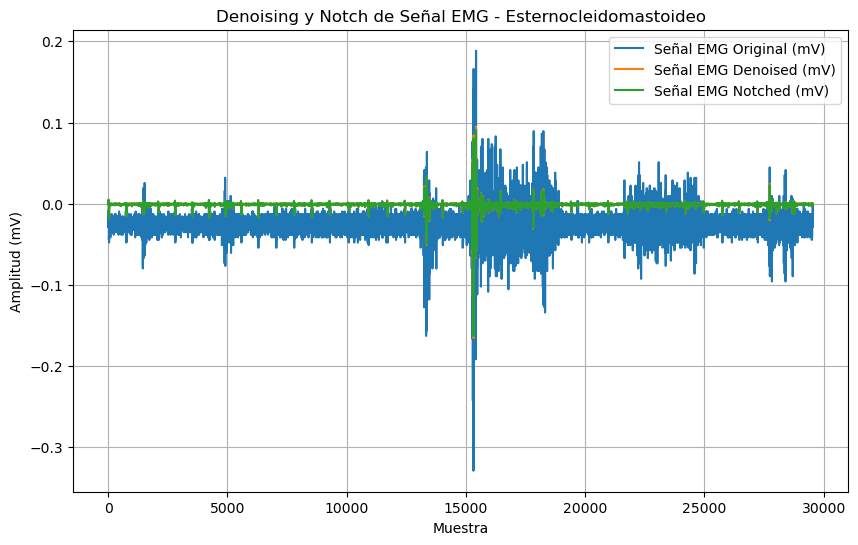

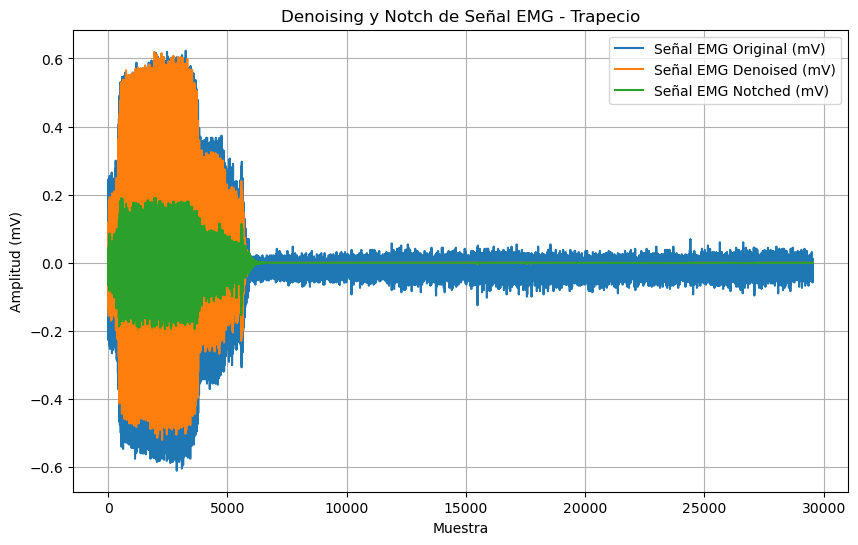

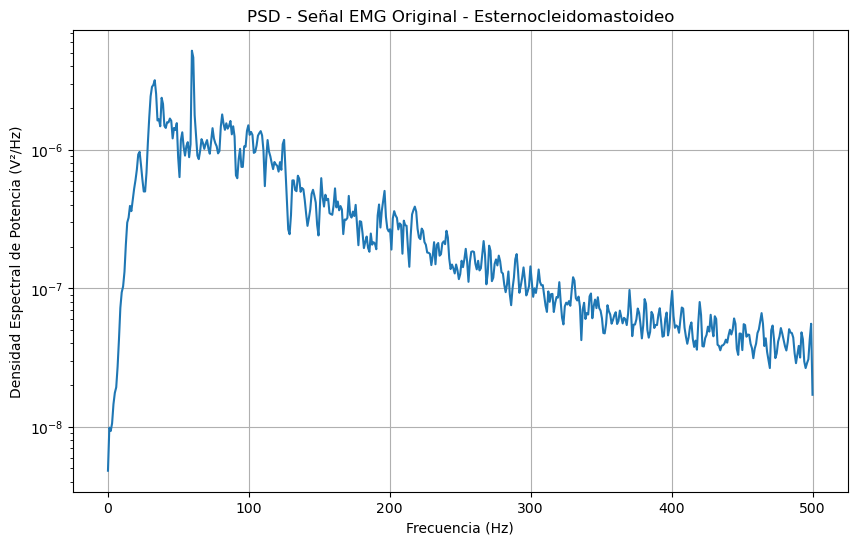

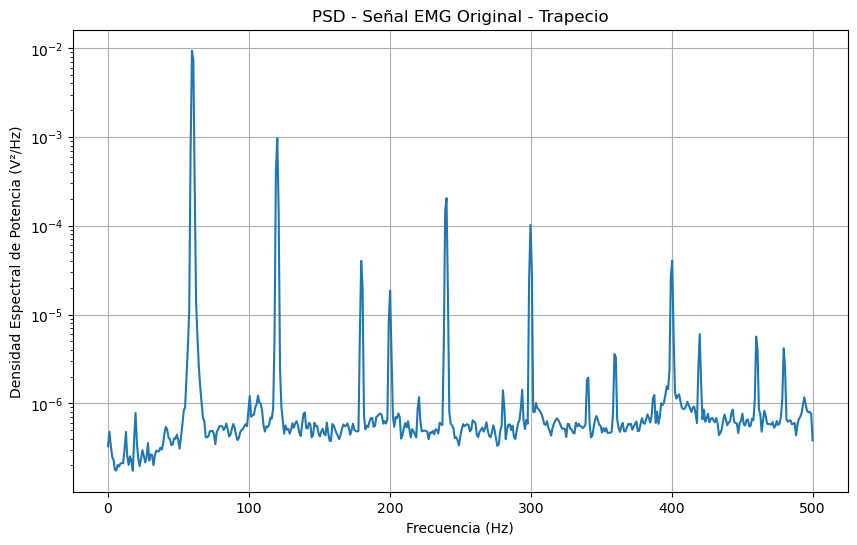

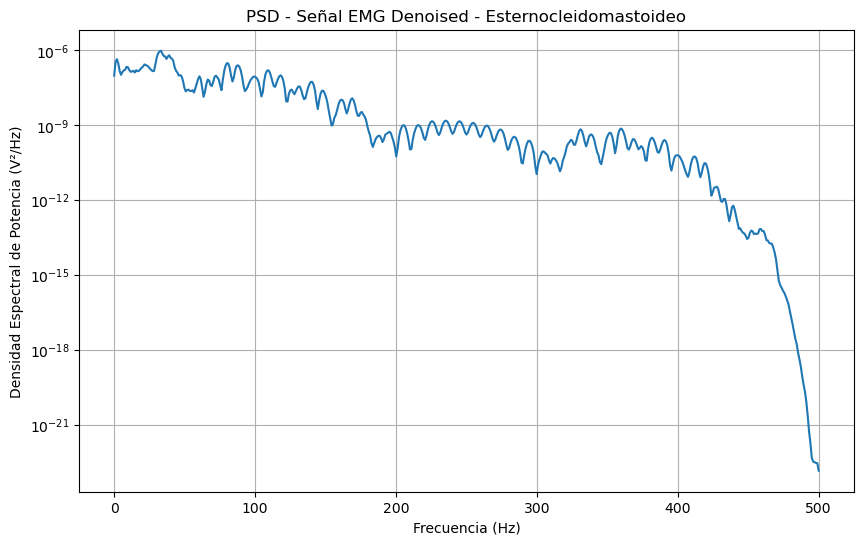

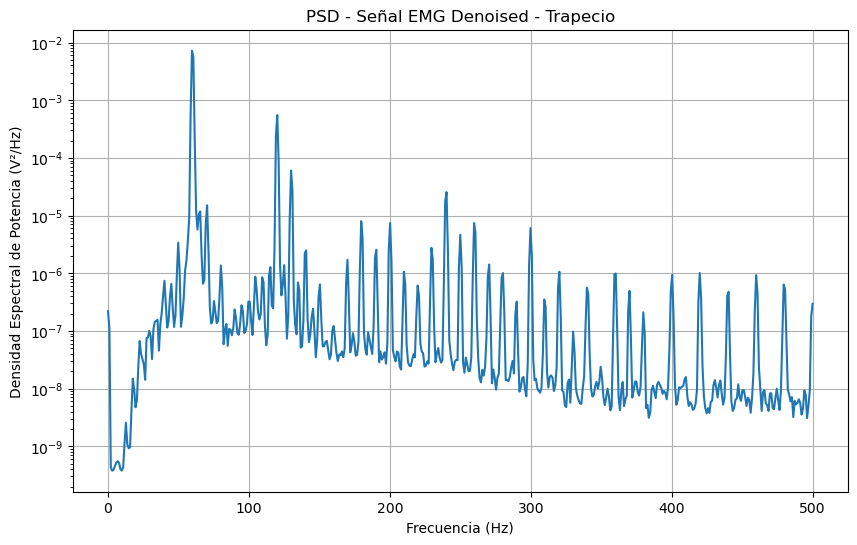

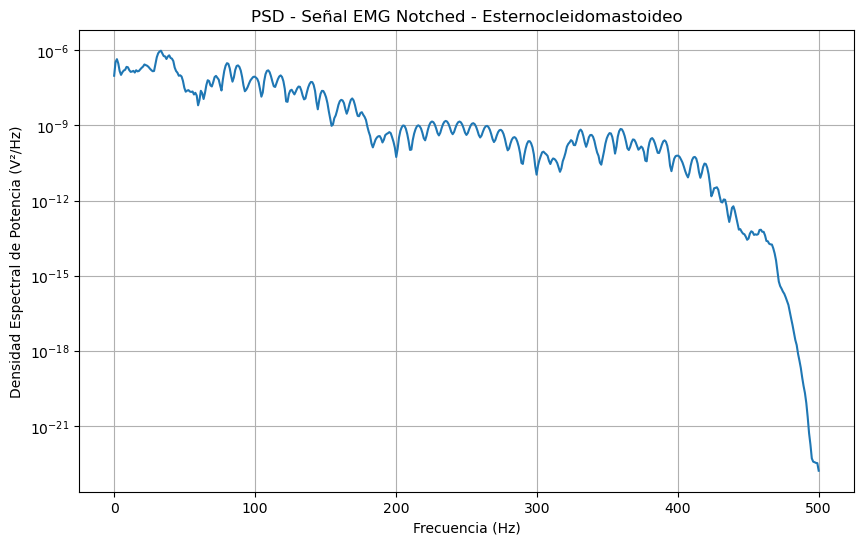

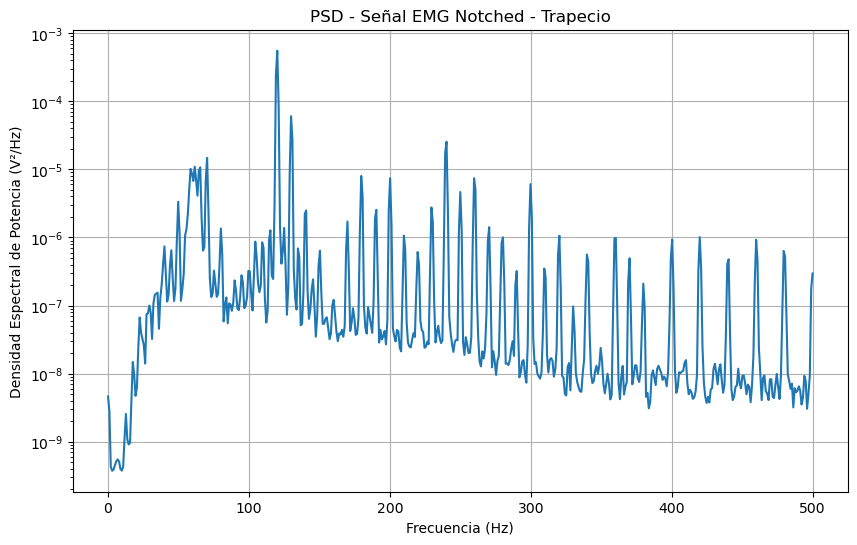

Se necesitaba filtro notch para esternocleidomastoideo: True
Se necesitaba filtro notch para trapecio: True


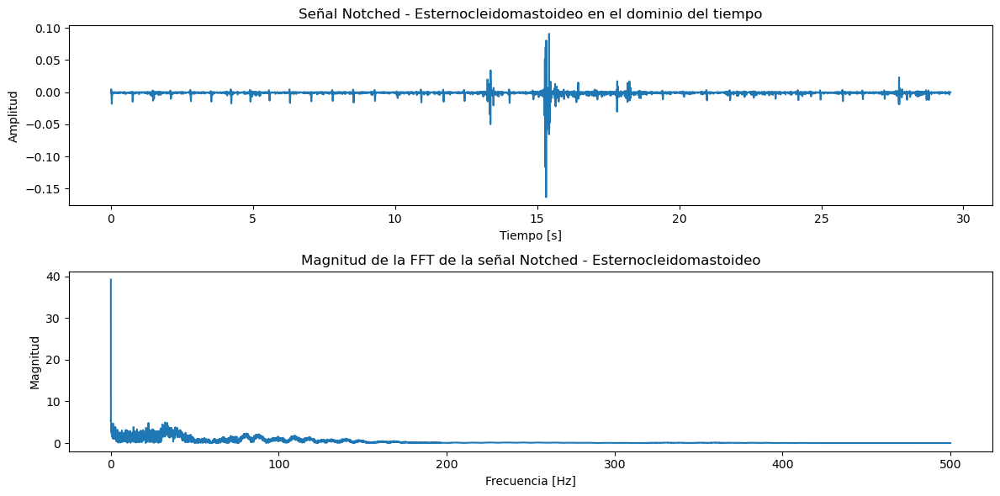

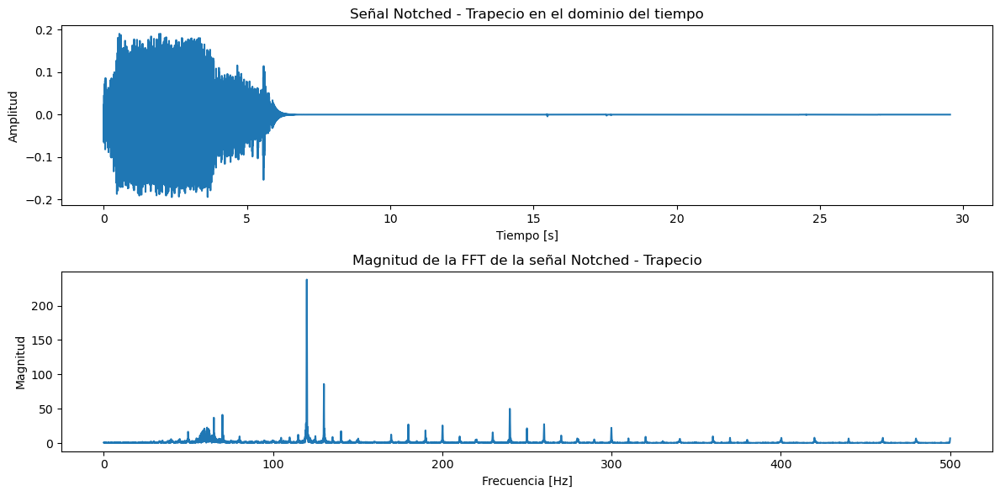

Maximum EMG - Esternocleidomastoideo: 0.09111015405132099
Minimum EMG - Esternocleidomastoideo: -0.1633347606706516
Average EMG - Esternocleidomastoideo: -0.0013288089107093765
Standard Deviation EMG - Esternocleidomastoideo: 0.00423236936466401


Burst End Times - Esternocleidomastoideo: [13.4994569  15.71353183]
Maximum time - Esternocleidomastoideo: 0.6090206126248088
Minimum time - Esternocleidomastoideo: 0.19200649856151664
Average time - Esternocleidomastoideo: 0.4005135555931627
Standard Deviation time - Esternocleidomastoideo: 0.20850705703164607


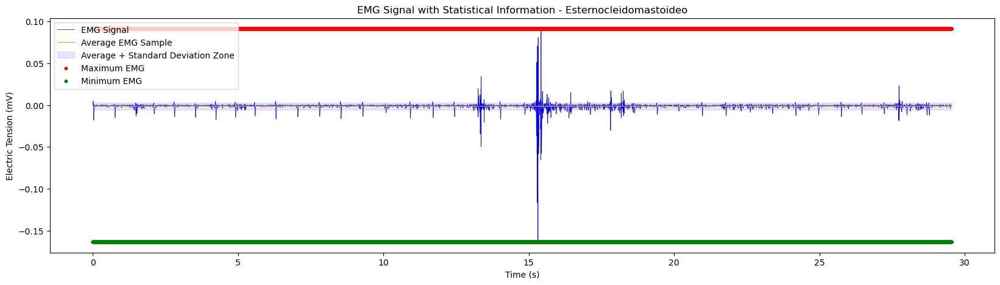

Características de la señal EMG:
  RMS: 0.004433510291129292
  Min: -0.260519970782379
  Max: 0.19435380228652635
  Median: -3.73120018463556e-10
  MAV: 0.0004446785765299705
  Std Dev: 0.0044218304928439495
El valor RMS de la señal EMG - Esternocleidomastoideo es: 0.00443606622585


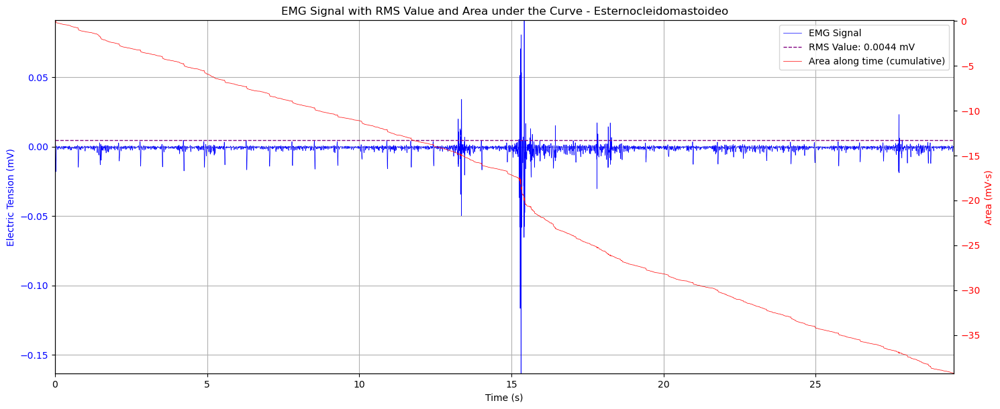

Frecuencia mediana (MDF) - Esternocleidomastoideo: 32.15325255533744 Hz
Frecuencia media (MNF) - Esternocleidomastoideo: 38.6599153811386 Hz
Maximum EMG - Trapecio: 0.19058940707103236
Minimum EMG - Trapecio: -0.19438373327610717
Average EMG - Trapecio: -2.0612184950337873e-05
Standard Deviation EMG - Trapecio: 0.03467840347945807


Burst End Times - Trapecio: [5.19217573]
Maximum time - Trapecio: 4.964168014892537
Minimum time - Trapecio: 4.964168014892537
Average time - Trapecio: 4.964168014892537
Standard Deviation time - Trapecio: 0.0


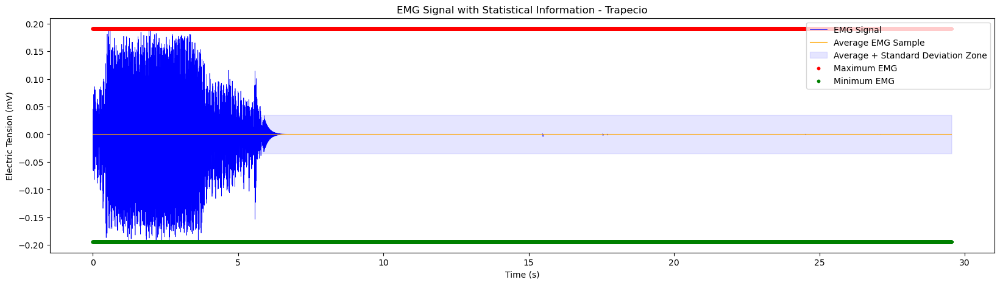

Características de la señal EMG:
  RMS: 0.03466852350042171
  Min: -0.3745740818001012
  Max: 0.39753804491977024
  Median: -8.909110208739756e-22
  MAV: 0.007338110971747864
  Std Dev: 0.034653326171486185
El valor RMS de la señal EMG - Trapecio es: 0.03467840960520332


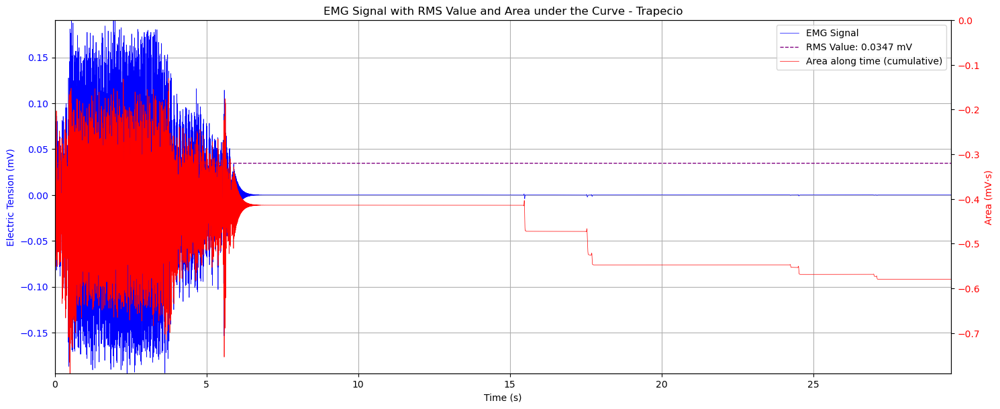

Frecuencia mediana (MDF) - Trapecio: 119.94855479591146 Hz
Frecuencia media (MNF) - Trapecio: 129.8009538957298 Hz


In [18]:
# Importar librerías
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt

# Definir constantes y parámetros
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_banda.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Función para procesar y convertir la señal
def procesar_senal(datos, columna):
    senal = datos[:, columna]
    senalV = (((senal / 1024) - 1 / 2) * 3.3) / 1009
    senalmV = senalV * fs  # en mV
    return senalmV

# Función para descomponer y denoising la señal usando transformada wavelet
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Función para aplicar filtro notch
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Función para graficar la señal EMG original y denoised
def graficar_senal(senalmV, emg_denoised, emg_notched, titulo):
    plt.figure(figsize=(10, 6))
    plt.plot(senalmV, label='Señal EMG Original (mV)')
    plt.plot(emg_denoised, label='Señal EMG Denoised (mV)')
    plt.plot(emg_notched, label='Señal EMG Notched (mV)')
    plt.xlabel('Muestra')
    plt.ylabel('Amplitud (mV)')
    plt.title(titulo)
    plt.legend()
    plt.grid(True)
    plt.show()

# Función para calcular y graficar la densidad espectral de potencia
def graficar_psd(senalmV, fs, titulo):
    f, Pxx = welch(senalmV, fs, nperseg=1024)
    plt.figure(figsize=(10, 6))
    plt.semilogy(f, Pxx)
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Densidad Espectral de Potencia (V²/Hz)')
    plt.title(titulo)
    plt.grid(True)
    plt.show()
    return f, Pxx

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar, denoising y graficar las señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
emg_denoised_esternocleidomastoideo = denoise_signal(senalmV_esternocleidomastoideo, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_esternocleidomastoideo = apply_notch_filter(emg_denoised_esternocleidomastoideo, f0, Q, fs)
graficar_senal(senalmV_esternocleidomastoideo, emg_denoised_esternocleidomastoideo, emg_notched_esternocleidomastoideo, 'Denoising y Notch de Señal EMG - Esternocleidomastoideo')

senalmV_trapecio = procesar_senal(datos, 11)
emg_denoised_trapecio = denoise_signal(senalmV_trapecio, wavelet, level, mode, threshold_method, threshold_value)
emg_notched_trapecio = apply_notch_filter(emg_denoised_trapecio, f0, Q, fs)
graficar_senal(senalmV_trapecio, emg_denoised_trapecio, emg_notched_trapecio, 'Denoising y Notch de Señal EMG - Trapecio')

# Graficar la densidad espectral de potencia de las señales originales
f_esternocleidomastoideo, Pxx_esternocleidomastoideo = graficar_psd(senalmV_esternocleidomastoideo, fs, 'PSD - Señal EMG Original - Esternocleidomastoideo')
f_trapecio, Pxx_trapecio = graficar_psd(senalmV_trapecio, fs, 'PSD - Señal EMG Original - Trapecio')

# Graficar la densidad espectral de potencia de las señales denoised
f_denoised_esternocleidomastoideo, Pxx_denoised_esternocleidomastoideo = graficar_psd(emg_denoised_esternocleidomastoideo, fs, 'PSD - Señal EMG Denoised - Esternocleidomastoideo')
f_denoised_trapecio, Pxx_denoised_trapecio = graficar_psd(emg_denoised_trapecio, fs, 'PSD - Señal EMG Denoised - Trapecio')

# Graficar la densidad espectral de potencia de las señales notched
f_notched_esternocleidomastoideo, Pxx_notched_esternocleidomastoideo = graficar_psd(emg_notched_esternocleidomastoideo, fs, 'PSD - Señal EMG Notched - Esternocleidomastoideo')
f_notched_trapecio, Pxx_notched_trapecio = graficar_psd(emg_notched_trapecio, fs, 'PSD - Señal EMG Notched - Trapecio')

# Determinar si se necesitaba el filtro notch
def check_notch_necessity(f, Pxx, f0):
    idx = np.where((f >= f0 - 1) & (f <= f0 + 1))[0]
    if np.any(Pxx[idx] > np.median(Pxx) * 10):  # Umbral arbitrario, ajustar según sea necesario
        return True
    return False

needed_notch_esternocleidomastoideo = check_notch_necessity(f_esternocleidomastoideo, Pxx_esternocleidomastoideo, f0)
needed_notch_trapecio = check_notch_necessity(f_trapecio, Pxx_trapecio, f0)

print(f"Se necesitaba filtro notch para esternocleidomastoideo: {needed_notch_esternocleidomastoideo}")
print(f"Se necesitaba filtro notch para trapecio: {needed_notch_trapecio}")

# Función para calcular y graficar la FFT de la señal
def graficar_fft(senal, fs, titulo):
    fft_result = np.fft.fft(senal)
    fft_freq = np.fft.fftfreq(len(senal), d=1/fs)
    
    # Solo mantener la mitad positiva del espectro
    positive_freq_idx = np.where(fft_freq >= 0)
    fft_freq = fft_freq[positive_freq_idx]
    fft_result = fft_result[positive_freq_idx]
    
    # Calcular la magnitud de la FFT
    fft_magnitude = np.abs(fft_result)
    
    # Graficar la señal y su FFT
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(np.arange(len(senal)) / fs, senal)
    plt.title(f'Señal {titulo} en el dominio del tiempo')
    plt.xlabel('Tiempo [s]')
    plt.ylabel('Amplitud')
    
    plt.subplot(2, 1, 2)
    plt.plot(fft_freq, fft_magnitude)
    plt.title(f'Magnitud de la FFT de la señal {titulo}')
    plt.xlabel('Frecuencia [Hz]')
    plt.ylabel('Magnitud')
    
    plt.tight_layout()
    plt.show()

# Calcular y graficar la FFT de las señales notched
graficar_fft(emg_notched_esternocleidomastoideo, fs, 'Notched - Esternocleidomastoideo')
graficar_fft(emg_notched_trapecio, fs, 'Notched - Trapecio')

# Existing imports and previous function definitions...
import numpy as np
import pywt
import matplotlib.pyplot as plt
from scipy.signal import welch, iirnotch, filtfilt
import biosignalsnotebooks as bsnb
from scipy.integrate import cumtrapz

# Function to process, denoise, notch, and calculate statistics
def process_and_analyze_emg(signal, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, title):
    # Denoise the signal
    emg_denoised = denoise_signal(signal, wavelet, level, mode, threshold_method, threshold_value)
    # Apply notch filter
    emg_notched = apply_notch_filter(emg_denoised, f0, Q, fs)
    # Calculate EMG statistics
    max_sample_value, min_sample_value, avg_sample_value, std_sample_value = calculate_emg_statistics(emg_notched, title)
    # Detect muscle activations
    burst_begin, burst_end = detect_muscle_activations(emg_notched, fs)
    calculate_burst_statistics(burst_begin, burst_end, title)
    # Plot graphical and statistical information
    t = np.arange(len(emg_notched)) / fs
    bsnb.plot_emg_graphical_statistical(t, emg_notched, max_sample_value, min_sample_value, avg_sample_value, std_sample_value)
    # Plot the EMG signal with statistical information
    plot_emg_with_statistics(t, emg_notched, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title)
    # Perform wavelet decomposition and statistics
    wavelet_analysis(emg_notched, wavelet, level, title)
    # Plot RMS and area under the curve
    plot_rms_and_area(t, emg_notched, title)
    # Perform frequency analysis
    frequency_analysis(emg_notched, fs, title)

# Function to plot the EMG signal with statistical information
def plot_emg_with_statistics(time, smooth_signal, avg_sample_value, std_sample_value, max_sample_value, min_sample_value, title):
    # Ensure all statistical arrays match the length of the time array
    avg_sample_array = np.full_like(time, avg_sample_value)
    std_sample_array = np.full_like(time, std_sample_value)
    max_sample_array = np.full_like(time, max_sample_value)
    min_sample_array = np.full_like(time, min_sample_value)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(20, 5))

    # Plot the EMG signal
    ax.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)

    # Plot the average EMG signal
    ax.plot(time, avg_sample_array, label='Average EMG Sample', color='orange', linewidth=0.8)

    # Plot the standard deviation zone
    ax.fill_between(time, avg_sample_array - std_sample_array, avg_sample_array + std_sample_array, color='blue', alpha=0.1, label='Average + Standard Deviation Zone')

    # Plot maximum and minimum EMG values with smaller markers
    ax.scatter(time, max_sample_array, label='Maximum EMG', color='red', s=10, zorder=3)  # Marker size set to 10
    ax.scatter(time, min_sample_array, label='Minimum EMG', color='green', s=10, zorder=3)  # Marker size set to 10

    # Set labels and title
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Electric Tension (mV)')
    ax.set_title(f'EMG Signal with Statistical Information - {title}')

    # Add legend
    ax.legend()

    # Display the plot
    plt.show()

# Function to perform wavelet decomposition and calculate statistics
def wavelet_analysis(signal, wavelet, level, title):
    coeffs = pywt.wavedec(signal, wavelet, level=level)
    all_coeffs = np.concatenate(coeffs)
    rms_total = np.sqrt(np.mean(np.square(all_coeffs)))
    min_total = np.min(all_coeffs)
    max_total = np.max(all_coeffs)
    median_total = np.median(all_coeffs)
    std_dev_total = np.std(all_coeffs)
    mav_total = np.mean(np.abs(all_coeffs))
    print("Características de la señal EMG:")
    print(f"  RMS: {rms_total}")
    print(f"  Min: {min_total}")
    print(f"  Max: {max_total}")
    print(f"  Median: {median_total}")
    print(f"  MAV: {mav_total}")
    print(f"  Std Dev: {std_dev_total}")

# Function to calculate RMS and plot the area under the curve
def plot_rms_and_area(time, smooth_signal, title):
    rms_value = np.sqrt(np.mean(np.square(smooth_signal)))
    print(f"El valor RMS de la señal EMG - {title} es: {rms_value}")
    area = cumtrapz(smooth_signal, initial=0)

    fig, ax1 = plt.subplots(figsize=(15, 6))
    ax1.plot(time, smooth_signal, label='EMG Signal', color='blue', linewidth=0.5)
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Electric Tension (mV)', color='blue')
    ax1.tick_params(axis='y', labelcolor='blue')

    ax2 = ax1.twinx()
    ax2.plot(time, area, label='Area along time (cumulative)', color='red', linewidth=0.5)
    ax2.set_ylabel('Area (mV·s)', color='red')
    ax2.tick_params(axis='y', labelcolor='red')

    ax1.axhline(y=rms_value, color='purple', linestyle='--', linewidth=1, label=f'RMS Value: {rms_value:.4f} mV')

    fig.tight_layout()
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper right')

    ax1.grid(True)
    ax1.set_xlim([0, max(time)])
    ax1.set_ylim([min(smooth_signal), max(smooth_signal)])
    ax2.set_ylim([min(area), max(area)])
    plt.title(f'EMG Signal with RMS Value and Area under the Curve - {title}')
    plt.show()

# Function to perform frequency analysis
def frequency_analysis(signal, fs, title):
    N = len(signal)
    freqs = np.fft.rfftfreq(N, 1/fs)
    fft_magnitude = np.abs(np.fft.rfft(signal))

    power_spectrum = fft_magnitude**2
    cumulative_power = np.cumsum(power_spectrum)
    total_power = cumulative_power[-1]
    median_freq_index = np.where(cumulative_power >= total_power / 2)[0][0]
    MDF = freqs[median_freq_index]
    print(f"Frecuencia mediana (MDF) - {title}: {MDF} Hz")

    MNF = np.sum(freqs * power_spectrum) / np.sum(power_spectrum)
    print(f"Frecuencia media (MNF) - {title}: {MNF} Hz")

# Function to detect muscle activations
def detect_muscle_activations(signal, fs, smooth_level=22, threshold_level=10):
    burst_begin, burst_end = bsnb.detect_emg_activations(signal, fs, smooth_level=smooth_level, threshold_level=threshold_level, time_units=True, plot_result=True)[:2]
    return burst_begin, burst_end

# Function to calculate and print burst durations and statistics
def calculate_burst_statistics(burst_begin, burst_end, title):
    bursts_time = burst_end - burst_begin
    print(f"Burst End Times - {title}: {burst_end}")
    
    max_time = np.max(bursts_time)
    min_time = np.min(bursts_time)
    avg_time = np.average(bursts_time)
    std_time = np.std(bursts_time)
    
    print(f"Maximum time - {title}: {max_time}")
    print(f"Minimum time - {title}: {min_time}")
    print(f"Average time - {title}: {avg_time}")
    print(f"Standard Deviation time - {title}: {std_time}")

# Function to calculate and return EMG signal statistics
def calculate_emg_statistics(signal, title):
    max_sample_value = np.max(signal)
    min_sample_value = np.min(signal)
    avg_sample_value = np.average(signal)
    std_sample_value = np.std(signal)
    
    print(f"Maximum EMG - {title}: {max_sample_value}")
    print(f"Minimum EMG - {title}: {min_sample_value}")
    print(f"Average EMG - {title}: {avg_sample_value}")
    print(f"Standard Deviation EMG - {title}: {std_sample_value}")
    
    return max_sample_value, min_sample_value, avg_sample_value, std_sample_value

# Function to denoise the signal using wavelet transform
def denoise_signal(senalmV, wavelet, level, mode, threshold_method, threshold_value):
    coefficients = pywt.wavedec(senalmV, wavelet, level=level, mode=mode)
    coefficients_thresh = [pywt.threshold(c, threshold_value, mode=threshold_method) for c in coefficients]
    emg_denoised = pywt.waverec(coefficients_thresh, wavelet, mode=mode)
    return emg_denoised

# Function to apply a notch filter
def apply_notch_filter(signal, f0, Q, fs):
    b, a = iirnotch(f0, Q, fs)
    filtered_signal = filtfilt(b, a, signal)
    return filtered_signal

# Main code to process both signals
archivo = "C:\\Universidad\\Señales\\Juan-20240702T154631Z-001\\Juan\\juan_banda.txt"
fs = 1000  # Frecuencia de muestreo usada en Bitalino
wavelet = 'sym5'  # Wavelet Symlet con 5 momentos de desaparición
level = 4  # Nivel de descomposición
mode = 'symmetric'  # Modo de extensión de señal
threshold_method = 'soft'  # Método de umbralización soft
threshold_value = 0.1  # Ajustar el valor del umbral según su señal y nivel de ruido
skip_lines = 7
f0 = 60.0  # Frecuencia a eliminar, en Hz
Q = 30.0  # Factor de calidad del filtro notch

# Leer los datos del archivo y omitir las primeras 7 líneas
datos = np.loadtxt(archivo, skiprows=skip_lines)

# Procesar y analizar señales
senalmV_esternocleidomastoideo = procesar_senal(datos, 5)
process_and_analyze_emg(senalmV_esternocleidomastoideo, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Esternocleidomastoideo")

senalmV_trapecio = procesar_senal(datos, 11)
process_and_analyze_emg(senalmV_trapecio, fs, wavelet, level, mode, threshold_method, threshold_value, f0, Q, "Trapecio")